# The most powerful people - Network analysis


### About _The World's Most Powerful People (Forbes)_
- Pulled from the "Forbes API"
- Some info about the article: https://www.forbes.com/sites/davidewalt/2018/05/08/the-worlds-most-powerful-people-2018/
    - considered hundreds of candidates from various walks of life all around the globe
    - measured their power along **four dimensions**:
        1. **power over lots of people**
        2. **financial resources controlled by each person**
            - heads of state: GDP
            - CEOs: measures like their company's assets and revenues 
            - high personal net worth
            - other valuable resources (access to oil)
        3. **powerful in multiple spheres**
        4. **candidates actively using their power**
- To calculate the final rankings, a panel of Forbes editors ranked all of our candidates in each of these four dimensions of power, and those individual rankings were averaged into a composite score.
- _"Any ranking of the world's most powerful people is going to be subjective, so we don't pretend ours is definitive. It's meant to be the beginning of a conversation, not the final word."_

## Docs

### Node attributes

#### All nodes
* `name`: str (only exists while graph construction)
* `wiki_title`: str (only exists while graph construction)
* `wiki_content`: str
* `wiki_links`: list[str]

#### People nodes
* `node_type`: str = "person"
* `age`: int
* `rank`: int
* `role`: str
* `government`: bool
* `gender`: str
* `category`: str

#### Country nodes
* `node_type`: str = "country"
* `region`: str
* `gdp`: float
* `population`: str

#### Organization nodes
_(Includes companies and other organizations)_
* `node_type`: str = "organization"
* `country`: str
* `market_value`: float

#### Community nodes
_(Includes communities)_
* `node_type`: str = "community"
* `community_type`: str
* `size`: float

### Imports and package installation
* Imports are located below in the "imports" code block.
* Installations of packages are located in the `requirements.txt` file.

In [1]:
# Imports
import wikipedia as wiki
import requests
from bs4 import BeautifulSoup
import pandas as pd
import networkx as nx
import numpy as np
import pickle
from scipy import stats
import community
import community.community_louvain as community_louvain
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib
from fa2 import ForceAtlas2

import wikipedia
import urllib.parse
import requests
import json

import nltk
from nltk.corpus import stopwords
import re

nltk.download('punkt')
nltk.download('stopwords')

import itertools
from sklearn.feature_extraction.text import TfidfVectorizer
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from wordcloud import WordCloud, STOPWORDS



[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


# Network creation

## Create nodes

### Configuration

Describes _flags_ that influence running the notebook, e.g. the graph will be loaded from a _.pickle_ file instead of donwloading all Wikipedia pages again.

In [2]:
REDOWNLOAD_FORBES_LIST = False
REDOWNLOAD_ALL_WIKI_FILES = False
RECREATE_ALL_LINKS = True
CORRECT_SUBSET_OF_NODES_FROM_WIKI = True
SHOW_VERBOSE = True

COUNTRY_COLOR = "#E52165" # Red
ORGANIZATION_COLOR = "#AFCD97" # Green
PEOPLE_COLOR = "#0D1137" # Blue

GREY_COLOR = "#D7D7D7" # Grey
EDGE_COLOR = "#EFDD6F" # Yellow

### Forbes most powerful people

We download and save powerful people from 2018 to `powerful_people.json`.

In [3]:
if REDOWNLOAD_FORBES_LIST:
    
    powerful_people_uri = 'https://www.forbes.com/ajax/list/data'
    params = {
        'year': '2018',
        'uri': 'powerful-people',
        'type': 'person',
    }

    response = requests.get(powerful_people_uri, params=params)

    with open('powerful_people.json', 'w') as file:
        json.dump(response.json(), file, indent=2)

The following imports powerful people from JSON into a dataframe.

In [4]:
def get_powerful_people() -> pd.DataFrame:
    powerful_people_df = pd.read_json("powerful_people.json")
    powerful_people_df = powerful_people_df.where(pd.notnull(powerful_people_df), None)
    # Overwrite organizations that are just countries with None
    powerful_people_df['organization'] = powerful_people_df.apply(
        lambda row: 
        None if row['organization'] in list(powerful_people_df['country'])
        else row['organization'], axis=1)
    return powerful_people_df

### Get countries from Wikipedia

We retrieve a list of countries from the Wikiepedia page _List of countries by GDP (nominal)_.

In [5]:
def download_countries_gdp_table():
    country_by_gdp_wiki = wiki.page('List of countries by GDP (nominal)') # Fetch the wiki page
    country_by_gdp_wiki_request = requests.get(country_by_gdp_wiki.url) # Request the whole HTML page

    country_by_gdp_soup = BeautifulSoup(country_by_gdp_wiki_request.text, 'lxml')

    table_soup = country_by_gdp_soup.find_all('table') # Find all html table tags
    filtered_table_soup = [table for table in table_soup if table.caption is not None] # Remove falsey None values if present

    required_table = None

    # Find  table with caption 'GDP (US$ million) by country'
    for table in filtered_table_soup:
        if str(table.caption.string).strip() == 'GDP (US$ million) by country':
            required_table = table
            break
    
    return required_table    

def preprocess_countries_gdp(table):
    countries_gdp_df = pd.read_html(table.prettify())[0] # Read html table to Pandas DataFrame
    # print(countries_gdp_df.columns)

    countries_gdp_df = countries_gdp_df.drop(labels = 0, axis = 0) # Drop the 'world' row
    

    cols = [3,4,5,6,7]
    countries_gdp_df.drop(countries_gdp_df.columns[cols],axis=1,inplace=True)

    columns = ['country', 'region', 'gdp']

    countries_gdp_df.columns = columns

    countries_gdp_df.to_json('countries_gdp.json')

    return countries_gdp_df

These are then downloaded and processed into a dataframe.

In [6]:
countries_gdp_table = download_countries_gdp_table()
countries_gdp_df = preprocess_countries_gdp(countries_gdp_table)

We expose a function `get_country_df()` to check whether countries have been downloaded and can be loaded from the file; or need to be downloaded again.

In [7]:
def get_country_df(): 
    try:
        countries_gdp_df = pd.read_json('countries_gdp.json')
        print('countries read from files')
        return countries_gdp_df
    except:
        print('countries not in files')
        countries_gdp_table = download_countries_gdp_table()
        countries_gdp_df = preprocess_countries_gdp(countries_gdp_table)
        print('countries downloaded from wiki')
        return countries_gdp_df    

### Forbes 2000 company list

We use the _Forbes Global 2000_ list that includes the global 2000 largest company and some key metrics. We include the _market value_ of companies in our network.

In [8]:
def getCompanies():
    # Opening JSON file
    with open('global2000.json') as json_file:
        data = json.load(json_file)
    return data['tableData']

def get_2000_companies_df():
    dfCompanies2000 = pd.DataFrame.from_dict(getCompanies())
    
    return dfCompanies2000[["rank", "organizationName", "country", "revenue", "profits", "assets", "marketValue"]]

# Now we have 2000 companies. Now we need to look through the wiki pages of the nodes and see if we find any of the companies listed in there. 
# First we create some functions which we will use later:


# Clean text for stop words
def cleanText(sample_str):
    stop_words = set(stopwords.words('english'))
    word_tokens  = nltk.word_tokenize(sample_str)
    filtered_sentence = [w for w in word_tokens if not w.lower() in stop_words]
    removedstopwords = ' '.join(filtered_sentence)
    return removedstopwords

# Get companies connected to a specific node
def getCompaniesConnectedToNode(person_wiki):
    a = pd.DataFrame()
    for index, row in dfCompanies2000.iterrows(): # For all companies
        if row["organizationName"] in person_wiki: # Check if 
            a = a.append(row,ignore_index = True)
    return a


# Go through all companies and check if they are in nodes wiki content. If yes then add the company to network
def updateNetworkWithCompany(G):
    for index, row in com_conn_to_person.iterrows():
        #for i in com_conn_to_person: # for every company connectd to that person
        if G.has_node(row["organizationName"]): # If the company is already a node, then just add edge 
            G.add_edge(node_name, row["organizationName"])
        else: # Add company as node and also edge
            G.add_node(
                row["organizationName"],
                assets=row["assets"],
                country=row["country"],
                marketValue=row["marketValue"],
                profits=row["profits"],
                rank=row["rank"],
                revenue=row["revenue"],
                type="organization"
            )
            G.add_edge(node_name, row["organizationName"])

    return G

### Create initial network with nodes

We initiate the network from the _Forbes Powerful People_ data. In this step, we only create a few links that can be extracted from this data, e.g., when person `p1` is from organization `o1` and in country `c1` there will be the links `p1 -> o1` and `p1 -> c1` created.

In [9]:
# Create the main DiGraph instance
G = nx.DiGraph()

ATTRIBUTE_PEOPLE_TYPE = "person"
ATTRIBUTE_COUNTRY_TYPE = "country"
ATTRIBUTE_ORGANIZATION_TYPE = "organization"

powerful_people = get_powerful_people()
companies = get_2000_companies_df()
countries = get_country_df()

# 1. Iterate through people and add links and nodes of its data
for index, row in powerful_people.iterrows():
    G.add_node(
        row["name"],
        age = int(row["age"]),
        role = row["title"],
        government = bool(row["government"]),
        gender = row["gender"],
        category = row["category"],
        rank = row["rank"],
        node_type = ATTRIBUTE_PEOPLE_TYPE
    )

    if row["country"] is not None:
        G.add_node(
            row["country"],
            node_type = ATTRIBUTE_COUNTRY_TYPE
        )
        G.add_edge(row["name"], row["country"])

    if row["organization"] is not None:
        G.add_node(
            row["organization"],
            node_type = ATTRIBUTE_ORGANIZATION_TYPE
        )
        G.add_edge(row["name"], row["organization"])


# 2. Add organizations (the data contains only companies) to network
for index, row in companies.iterrows():
    G.add_node(
        row["organizationName"],
        market_value = row["marketValue"],
        country = row["country"],
        node_type = ATTRIBUTE_ORGANIZATION_TYPE
    )

    if row["country"] is not None:
        # If node of this country doesn't exist yet, create it
        if row["country"] not in G.nodes():
            G.add_node(
                row["country"],
                node_type = ATTRIBUTE_COUNTRY_TYPE
            )
        # Add link from this organization to the associated country
        G.add_edge(row["organizationName"], row["country"])


# 3. Add countries
for index, row in countries.iterrows():
    G.add_node(
        row["country"],
        node_type = ATTRIBUTE_COUNTRY_TYPE,
        gdp = row["gdp"],
        region = row["region"]
    )


countries read from files


## Download Wikipedia content

We'll try to download the _page content,_ _Wikipedia links_ and _page title_ for each of the nodes from the network that was just created. Not all nodes can be found easily by the node name from the _Forbes_ list, therefore, manual mappings are included that take precedence for looking up Wikipedia pages. Finally, we rename all nodes to match exactly their Wikipedia title to simplify the link creation.


### Manual mappings for Wikipedia pages

In [10]:
# Dictionary of manual mappings between node-name and Wikipedia title

manual_wikipedia_mappings = {
    "Chase": "Chase Bank",
    "Shell": "Shell_plc",
    "Total": "TotalEnergies",
    "RBC": "RBC_Bank",
    "Industrial bank": "Industrial_Bank_(China)",
    "Santander": "Santander_Bank",
    "Vale": "Vale_S.A.",
    "Visa": "Visa_Inc.",
    "Target": "Target_Corporation",
    "Linde": "Linde_plc",
    "ANZ": "Australia_and_New_Zealand_Banking_Group",
    "Dow": "Dow_Inc.",
    "PTT": "PTT_Public_Company_Limited",
    "HP": "HP_Inc.",
    "National Grid": "National_Grid_(Great_Britain)",
    "PICC": "People's_Insurance_Company_of_China",
    "Blackstone": "Blackstone_Inc.",
    "CRH": "CRH_plc",
    "Woolworths": "Woolworths_Group_(United_Kingdom)",
    "Eaton": "Eaton_Corporation",
    "SK": "SK_Group",
    "Aegon": "Aegon_N.V.",
    "Canon": "Canon_Inc.",
    "Komatsu": "Komatsu_Limited",
    "Continental": "Continental_AG",
    "Williams": "Williams_Companies",
    "Orange": "Orange_S.A.",
    "Bunge": "Bunge_Limited",
    "Prudential": "Prudential_plc",
    "Loews": "Loews_Corporation",
    "CSL": "CSL_Limited",
    "Corning": "Corning_Inc.",
    "Ferguson": "Ferguson_plc",
    "PPG": "PPG_Industries",
    "Kellogg": "Kellogg's",
    "Gallagher": "Gallagher_Group_(UK)",
    "KLA": "KLA_Corporation",
    "Siemens Energy": "Siemens_Energy_AG",
    "ITC": "ITC_Limited",
    "HMM": "HMM_(company)",
    "Allegheny": "Alleghany_Corp.",
    "VF": "VF_Corporation",
    "SMC": "SMC_Corporation",
    "Kao": "Kao_Corporation",
    "Block": "Block,_Inc.",
    "Legrand": "Legrand_(company)",
    "AGC": "AGC_Inc.",
    "UCB": "UCB_(company)",
    "Flex": "Flex_(company)",
    "CGI": "CGI_Inc.",
    "Scor": "SCOR_SE",
    "Hess": "Hess_Corporation",
    "NVR": "NVR,_Inc.",
    "Olympus": "Olympus_Corporation",
    "Eastman": "Kodak",
    "Santos": "Santos_Limited",
    "Goodyear": "Goodyear_Tire_and_Rubber_Company",
    "Metro": "Metro_AG",
    "Sharp": "Sharp_Corporation",
    "Popular": "Popular,_Inc.",
    "PPL": "PPL_Corporation",
    "APA": "APA_Corporation",
    "Wendel": "Wendel_(group)",
    "Olin": "Olin_Corporation",
    "XP": "XP_Inc.",
    "SGS": "SGS_S.A.",
    "Ventas": "Ventas_(company)",
    "SLM": "SLM_Corporation",
    "Hilton": "Hilton_Worldwide",
    "B3": "B3_(stock_exchange)",
    "WEG": "WEG_Industries",
    "Taisei": "Taisei_Corporation",
    "Snap": "Snap_Inc.",
    "Next": "Next_plc",
    "Huntsman": "Huntsman_Corporation",
    "M3": "3M",
    "SQM": "Sociedad_Química_y_Minera",
    "Waters": "Waters_Corporation",
    "Pan Pacific": "Pan_Pacific_Hotels_and_Resorts",
    "Lear": "Lear_Corporation",
    "Saputo": "Saputo_Inc.",
    "Shimizu": "Shimizu_Corporation",
    "SCA": "SCA_(company)",
    "Parkland": "Parkland_Corporation",
    "Gap": "Gap_Inc.",
    "Albemarle": "Albemarle_Corporation",
    "NMDC": "National_Mineral_Development_Corporation",
    "PTT ": "PTT_Public_Company_Limited",
    "VINCI": "Vinci_SA",
    "Travelers": "The_Travelers_Companies",
    "Progressive": "Progressive_Corporation",
    "American Electric": "American_Electric_Power",
    "Woolworths": "Woolworths_Group_(United_Kingdom)",
    "PPG ": "PPG_Industries",
    "Alleghany": "Alleghany_Corporation",
    "Kao ": "Kao_Corporation",
    "HBIS": "Hesteel_Group",
    "UGI": "UGI_Corporation",
    "Georgia": "Georgia_(country)",
    "Palestine": "State_of_Palestine",
    "Congo": "Democratic_Republic_of_the_Congo",
    "Apple": "Apple_Inc."
}


# In case of a retry, not all Wikipedia pages will be downloaded but the following ones will be corrected:
# They will be removed or redownloaded

nodes_to_drop = [
    # no wiki articles:
    "Kaisa Group Holdings",
    "Pool",
    'Pan Pacific International Holdings',
]


"""
Empty dictionary as this was only needed within the download process.
Add nodes here that need to be re-downloaded, without downloading everything again.

For this the configuration flags should be set accordingly:
    REDOWNLOAD_ALL_WIKI_FILES = False
    CORRECT_SUBSET_OF_NODES_FROM_WIKI = True
"""
redownload_nodes = {
    # Example:
    # "Apple": "Apple_Inc.",
    # "Georgia": "Georgia_(country)",
}

### Download Wikipedia pages

We define functions to download Wikipedia pages with some error handling involved. This also considers the manual mappings definied earlier. The [`wikipedia`](https://github.com/goldsmith/Wikipedia) library is used (it wraps around the Wikipedia API) for convenience. Wikipedia pages are all save as files into `./wiki_files/<page_title>.json`.

The function `enrich_with_wiki_content_and_wiki_title(graph, node_subset)` eventually searches, downloads, and adds Wikipedia information to the graph.

In [11]:
# For all nodes, get the wikipedia content as "wiki_content" and "wiki_link"
WIKI_LINKS_ATTR = 'wiki_links'
WIKI_TITLE_ATTR = 'wiki_title'
WIKI_CONTENT_ATTR = 'wiki_content'

def get_wiki_page(query: str, opt=0) -> wikipedia.WikipediaPage:
    """ Get the link with `wiki.title` and content with `wiki.content` """
    try:
        # If there's a manual mapping existing, use that to find Wiki page
        if query in manual_wikipedia_mappings:
            wiki_page = wikipedia.page(manual_wikipedia_mappings[query], auto_suggest=False)

        else:
            print(f'\rQuerying Wikipedia for {query}', end='')
            wiki_link = wikipedia.search(query, results=1)

            if len(wiki_link) == 0:
                return None
            else:
                wiki_link = wiki_link[0]

            print(f'\rWiki-article-id = {wiki_link} ', end="")
            wiki_page = wikipedia.page(wiki_link, auto_suggest=False)

    except wikipedia.DisambiguationError as e:
        if opt==1:
            print("Ran too many times, stopping now")
            return None
        else:
            if e.options[0]:
                print(f'DisambiguationError ocurrred, trying againg with "{e.options[0]}"')
                return get_wiki_page(e.options[0], 1)
            else:
                print(f'DisambiguationError ocurrred for "{query}"')
                return None

    return wiki_page


def save_wiki_page(page: wikipedia.WikipediaPage) -> None:
    """ Saves wikipeida page to a JSON file, keeping only title, content and links """
    with open(f'wiki_files/{page.title}.json', 'w') as json_file:
        
        wiki_as_dict = {
            "title": page.title,
            "content": page.content,
            "links": page.links
            }

        json.dump(wiki_as_dict, json_file, indent=2)


def enrich_with_wiki_content_and_wiki_title(graph: nx.Graph, node_subset=None) -> None:
    nodes_to_download = (node_subset
                        if node_subset is not None
                        else graph.nodes())

    for i, node in enumerate(nodes_to_download, start=1):
        print(f"\rDownloading Wikipedia page: {node}", end='')
        wiki_page = get_wiki_page(node)
    
        if wiki_page is not None:
            print(f"\rSaving Wikipedia page: {wiki_page.title}", end='')
            save_wiki_page(wiki_page)

            graph.nodes[node][WIKI_TITLE_ATTR] = wiki_page.title
            graph.nodes[node][WIKI_CONTENT_ATTR] = wiki_page.content
            graph.nodes[node][WIKI_LINKS_ATTR] = wiki_page.links

    print()

### Helper functions to read/save graph from file

In [12]:
def save_graph() -> None:
    with open('graph.pickle', 'wb') as handle:
        print("Write graph to pickle file")
        pickle.dump(G, handle, protocol=pickle.HIGHEST_PROTOCOL)


def init_graph_from_file() -> nx.Graph:
    with open('graph.pickle', 'rb') as handle:
        G = nx.DiGraph(pickle.load(handle))
    
    return G

### Perform download of Wikipedia pages based on configuration flags

We plug everything together, considering our _configuration flags_ set in the beginning of this notebook. The overall networks is exposed in the variable `G`.

In [13]:
if CORRECT_SUBSET_OF_NODES_FROM_WIKI:
    print("CORRECT_SUBSET_OF_NODES_FROM_WIKI")
    G = init_graph_from_file()
    G.remove_nodes_from(nodes_to_drop)
    enrich_with_wiki_content_and_wiki_title(G, node_subset=redownload_nodes)
    save_graph()

elif REDOWNLOAD_ALL_WIKI_FILES:
    print("REDOWNLOAD_ALL_WIKI_FILES")
    enrich_with_wiki_content_and_wiki_title(G)
    save_graph()

else:
    print("Lading graph from file...")
    G = init_graph_from_file()

CORRECT_SUBSET_OF_NODES_FROM_WIKI

Write graph to pickle file


## Create network links based on _Wikipedia_ links

To add all links from Wikipeida to the network, we iterate through all nodes in the network, and add the the links from Wikipedia as network links. We also rename nodes to all match their Wikipedia page name (which one could refer to as their "id"). We remove node attributes that are no longer needed.

In [14]:
def rename_nodes_to_wiki_title(graph: nx.Graph) -> None:
    nx.relabel_nodes(graph, create_rename_mapping(graph))
    remove_attribute_from_all_nodes(graph, WIKI_TITLE_ATTR)

def create_rename_mapping(graph: nx.Graph):
    result = {original_name: graph.nodes[original_name][WIKI_TITLE_ATTR] for original_name in graph.nodes()
              if WIKI_TITLE_ATTR in G.nodes[original_name]}

    return result

def remove_attribute_from_all_nodes(graph: nx.Graph, attribute: str) -> None:
    for node_name in graph.nodes():
        if attribute in graph.nodes[node_name]:
            del graph.nodes[node_name][attribute]

def generate_links_from_wiki_attributes(graph: nx.Graph) -> None:
    number_of_nodes = graph.number_of_nodes()

    rename_nodes_to_wiki_title(graph)

    for i, source_node_name in enumerate(graph.nodes(), start=1):
        # Print current status
        print(f'\rNode {i}/{number_of_nodes}', end='')
        
        # Check that attribute WIKI_LINKS_ATTR exists to avoid 'KeyError'
        if WIKI_LINKS_ATTR in graph.nodes[source_node_name]:

            # For all outgoing links of the current node
            for target_node_name in graph.nodes[source_node_name][WIKI_LINKS_ATTR]:

                if (target_node_name in graph.nodes() and
                    source_node_name != target_node_name):

                    graph.add_edge(source_node_name, target_node_name)

We run the functions defined in the block above:

In [15]:
if RECREATE_ALL_LINKS:
    print("RECREATE_ALL_LINKS")
    generate_links_from_wiki_attributes(G)
    print()
    save_graph()

else:
    G = init_graph_from_file()

RECREATE_ALL_LINKS
Node 2318/2318
Write graph to pickle file


We define a utility function to return a list of colors depending on its node type for graph visualizations.

In [16]:
def generate_node_colors(graph: nx.Graph):
    node_colors = []

    for node_name in graph.nodes:
        node_type = graph.nodes[node_name]["node_type"]
        if node_type == "country":
            node_colors.append(COUNTRY_COLOR)
        elif node_type == "person":
            node_colors.append(PEOPLE_COLOR)
        elif node_type == "organization":
            node_colors.append(ORGANIZATION_COLOR)
        else:
            node_colors.append("black")

    return node_colors

In [17]:
# Plot network
def plot_graph(graph: nx.Graph, title="Graph title"): 

    plt.figure(figsize=(20, 20))
    plt.title(title)
    pos = nx.spring_layout(graph, k=0.8, iterations=100)
    # k controls the distance between the nodes and varies between 0 and 1
    # iterations is the number of times simulated annealing is run
    # default k=0.1 and iterations=50
    # pos = nx.spring_layout(G, scale=20, k=3/np.sqrt(G.order()))
    d = dict(graph.degree)

    nx.draw(
        graph,
        pos,
        node_color=generate_node_colors(graph),
        with_labels=True,
        node_size=400,
        font_size=8,
        width=0.75,
        edge_color="gray",
    )

To get a first impression, we visualize an early version of the graph without further enhancements:

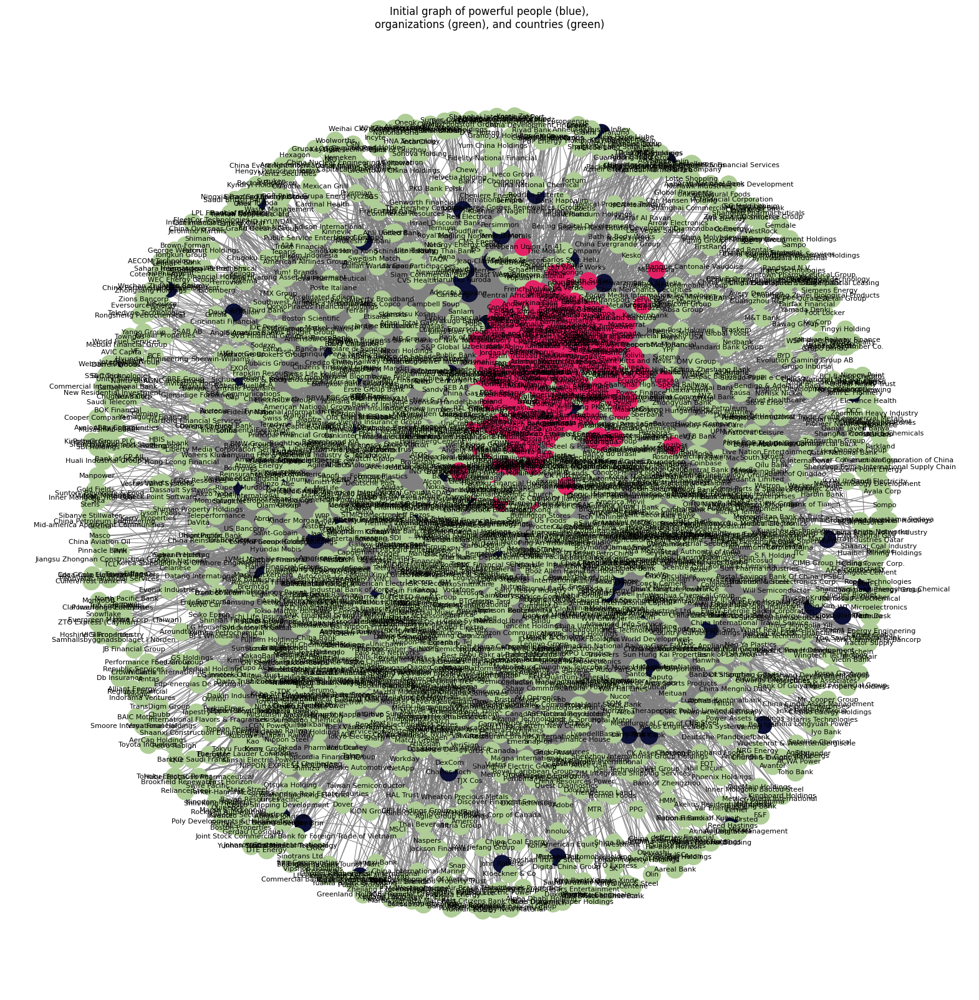

In [18]:
plot_graph(G.to_undirected(), """Initial graph of powerful people (blue),
organizations (green), and countries (green)""")

And here we peak at the _organizations_ (=_companies_) data. For further analysis we only consider the market value.

In [19]:
companies.head()

,rank,organizationName,country,revenue,profits,assets,marketValue
0,1.,Berkshire Hathaway,United States,$276.09 B,$89.8 B,$958.78 B,$741.48 B
1,2.,ICBC,China,$208.13 B,$54.03 B,"$5,518.51 B",$214.43 B
2,3.,Saudi Arabian Oil Company (Saudi Aramco),Saudi Arabia,$400.38 B,$105.36 B,$576.04 B,"$2,292.08 B"
3,4.,JPMorgan Chase,United States,$124.54 B,$42.12 B,"$3,954.69 B",$374.45 B
4,5.,China Construction Bank,China,$202.07 B,$46.89 B,"$4,746.95 B",$181.32 B


# Network analysis

## Analysis ideas

* We wish to investigate - **How network analysis can describe why these people are the most powerful and influence each other and the world around them?**
* We hope to discover **what combinations of people, countries, companies, organization etc. makes one of the worlds powerful people** i.e.
* What are the **common denominator** of the of these people?
* **What is influenced** by the most powerful people i.e. countries, companies, organization or other people of power?
* Can we **find communities** based on how these people, companies etc. are described?



## Visualizing the graph
The following figure visualizes the undirected version of our graph (using the _Force Atlas 2_ alogrithm).

100%|██████████| 2000/2000 [01:00<00:00, 32.97it/s]
BarnesHut Approximation  took  41.10  seconds
Repulsion forces  took  14.25  seconds
Gravitational forces  took  0.22  seconds
Attraction forces  took  2.37  seconds
AdjustSpeedAndApplyForces step  took  1.19  seconds


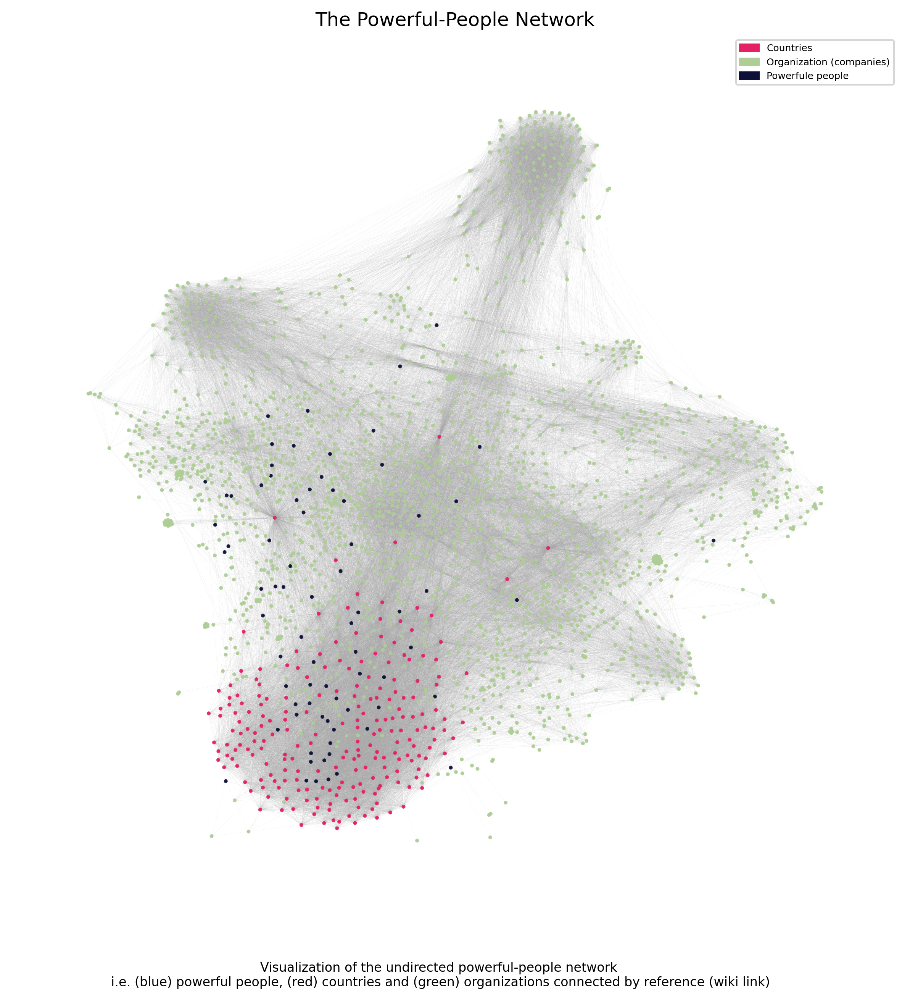

In [125]:
import matplotlib.patches as mpatches

def plot_fa2_undirected_without_self_loops(graph: nx.Graph,
                                           title="Undirected graph",
                                           figure_text="",
                                           node_size=1) -> None:
    """
    Plots a graph including a legend for countries, people, organizations.
    
    node_size: int, list[int]
    """
    graph = nx.Graph(graph)
    graph.remove_edges_from(nx.selfloop_edges(graph))

    fig = plt.figure(1, figsize=(10, 10), dpi=300)
    plt.title(title)
    fig.text(.5, .05, figure_text, ha = 'center', fontsize = 8)

    forceatlas2 = ForceAtlas2(
        # Behavior alternatives
        outboundAttractionDistribution=False, # Dissuade hubs: Distributes attraction along outbound edges. Hubs attract less and thus are pushed to the borders
        adjustSizes=False,
        edgeWeightInfluence=1.0,

        # Performance
        # How much swinging you allow. Above 1 discouraged. Lower gives less speed and more precision
        jitterTolerance=1.0,
        # Barnes Hut optimization, n2 complexity to n.ln(n)
        barnesHutOptimize=True,
        barnesHutTheta=1.8,  # 1.2

        # Tuning
        scalingRatio=10,  # How much repulsion you want. More makes a more sparse graph
        strongGravityMode=False,  # A stronger gravity view
        gravity=0.01,  # Attracts nodes to the center. Prevents islands from drifting away

        # Log
        verbose=True)

    positions = forceatlas2.forceatlas2_networkx_layout(
        graph, pos=None, iterations=2000)

    nx.draw_networkx_nodes(graph, positions, node_size=node_size,
                           node_color=generate_node_colors(graph), alpha=0.9)
    # nx.draw_networkx_labels(graph, positions, font_size=4)
    nx.draw_networkx_edges(
        graph, positions, edge_color="DarkGrey", width=0.02, alpha=0.9)
        
    country_patch = mpatches.Patch(color=COUNTRY_COLOR, label='Countries')
    organization_patch = mpatches.Patch(color=ORGANIZATION_COLOR, label='Organization (companies)')
    people_patch = mpatches.Patch(color=PEOPLE_COLOR, label="Powerfule people")
    
    plt.legend(handles=[country_patch, organization_patch, people_patch], prop={'size': 6})

    plt.axis('off')
    plt.savefig('filename.png', dpi=300)
    plt.show()

_figure_text = """Visualization of the undirected powerful-people network 
i.e. (blue) powerful people, (red) countries and (green) organizations connected by reference (wiki link)"""

plot_fa2_undirected_without_self_loops(
    G, title="The Powerful-People Network", figure_text=_figure_text, node_size=2)

In [21]:
print(f"Visualization of the entire graph with {G.number_of_nodes()} nodes and {G.number_of_edges()} edges.")

Visualization of the entire graph with 2318 nodes and 79294 edges.


## Important figures about the network



### General

We list some general information about the network and its parts, the people-, country-, and organization-nodes.

In [22]:
print(f"Number of total nodes: {G.number_of_nodes()}")
print(f"Number of total links: {G.number_of_edges()}")

Number of total nodes: 2318
Number of total links: 79294


Lists _Mode_, _Mean_, _Median_ and _Min_/_Max_ of in- and out-degrees:

In [23]:
from scipy import stats

in_degrees = [d for n, d in list(G.in_degree)]
out_degrees = [d for n, d in list(G.out_degree)]


def print_stats(degree_list, comment):
    print(f'Mode ({comment}): {stats.mode(degree_list).mode[0]}')
    print(f'Mean ({comment}): {np.mean(degree_list)}')
    print(f'Median ({comment}): {np.median(degree_list)}')
    print(f'Min ({comment}): {min(degree_list)}')
    print(f'Max ({comment}): {max(degree_list)}')


def get_filtered_degree_tuple_list(degree_view, node_type):
    filtered_degrees = []
    for node, degree in degree_view:
        if G.nodes(data=True)[node]["node_type"] == node_type:
            filtered_degrees.append((node, degree))
    return filtered_degrees


def get_degree_list(degree_view, node_type):
    return [d for n, d in get_filtered_degree_tuple_list(degree_view, node_type)]

in_degrees_people = [d for n, d in get_filtered_degree_tuple_list(G.in_degree, ATTRIBUTE_PEOPLE_TYPE)]
out_degrees_people = [d for n, d in get_filtered_degree_tuple_list(G.out_degree, ATTRIBUTE_PEOPLE_TYPE)]

print("### Combined network ###")
print()
print_stats(in_degrees, 'in')
print()
print_stats(out_degrees, 'out')
print()
print()
print("### Powerful people ###")
print()
print_stats(get_degree_list(G.in_degree, ATTRIBUTE_PEOPLE_TYPE), 'in')
print()
print_stats(get_degree_list(G.out_degree, ATTRIBUTE_PEOPLE_TYPE), 'out')
print()
print()
print("### Countries ###")
print()
print_stats(get_degree_list(G.in_degree, ATTRIBUTE_COUNTRY_TYPE), 'in')
print()
print_stats(get_degree_list(G.out_degree, ATTRIBUTE_COUNTRY_TYPE), 'out')
print()
print()
print("### Organizations (companies) ###")
print()
print_stats(get_degree_list(G.in_degree, ATTRIBUTE_ORGANIZATION_TYPE), 'in')
print()
print_stats(get_degree_list(G.out_degree, ATTRIBUTE_ORGANIZATION_TYPE), 'out')
print()


### Combined network ###

Mode (in): 0
Mean (in): 34.20793787748059
Median (in): 4.0
Min (in): 0
Max (in): 1012

Mode (out): 1
Mean (out): 34.20793787748059
Median (out): 21.0
Min (out): 0
Max (out): 367


### Powerful people ###

Mode (in): 0
Mean (in): 9.586666666666666
Median (in): 6.0
Min (in): 0
Max (in): 114

Mode (out): 6
Mean (out): 38.22666666666667
Median (out): 14.0
Min (out): 2
Max (out): 211


### Countries ###

Mode (in): 109
Mean (in): 138.08715596330276
Median (in): 122.5
Min (in): 0
Max (in): 1012

Mode (out): 126
Mean (out): 92.9908256880734
Median (out): 95.0
Min (out): 8
Max (out): 188


### Organizations (companies) ###

Mode (in): 0
Mean (in): 23.93679012345679
Median (in): 2.0
Min (in): 0
Max (in): 261

Mode (out): 1
Mean (out): 27.730864197530863
Median (out): 17.0
Min (out): 0
Max (out): 367



### Degree distribution


In this section, we plot the degree distributions of our overall network and of its subgraphs.

In [115]:
def plot_in_and_out_degree_distribution(graph: nx.DiGraph(),
                                        bin_count=50,
                                        figsize=(12, 12),
                                        y_log_scale=False):
    in_degrees = [graph.in_degree(n) for n in graph.nodes()]
    out_degrees = [graph.out_degree(n) for n in graph.nodes()]

    bin_edges = np.histogram(in_degrees + out_degrees, bins=bin_count)[1]

    in_degrees_histogram = np.histogram(in_degrees, bins=bin_edges)
    out_degrees_histogram = np.histogram(out_degrees, bins=bin_edges)

    out_degrees_histogram_density = np.histogram(out_degrees, bins=max(out_degrees), density=True)
    in_degrees_histogram_density = np.histogram(in_degrees, bins=max(in_degrees), density=True)

    plt.figure(figsize=figsize)

    plt.subplot(2, 2, 1)

    max_count_in_degree = max(in_degrees_histogram[0])
    max_count_out_degree = max(out_degrees_histogram[0])
    max_y_limit = max(max_count_in_degree, max_count_out_degree)

    # Reset matplotlib in order to use Seaborn desing
    matplotlib.rc_file_defaults()

    sns.histplot(in_degrees, bins=bin_edges, log_scale=(False, y_log_scale))
    plt.ylim(top=max_y_limit)
    plt.xlabel("In-degree")
    plt.title("In-degree distribution")

    plt.subplot(2, 2, 2)

    sns.histplot(out_degrees, bins=bin_edges, log_scale=(False, y_log_scale))
    plt.ylim(top=max_y_limit)
    plt.xlabel("Out-degree")
    plt.title("Out-degree distribution")

    plt.subplot(2, 2, 3)
    sns.scatterplot(x=in_degrees_histogram_density[1][:-1], y=in_degrees_histogram_density[0])
    plt.yscale("log")
    plt.xscale("log")
    plt.xlabel("In-degree")
    plt.ylabel("$p_k$")
    plt.title("In-degree distribution (log-log)")

    plt.subplot(2, 2, 4)
    sns.scatterplot(x=out_degrees_histogram_density[1][:-1], y=out_degrees_histogram_density[0])
    plt.yscale("log")
    plt.xscale("log")
    plt.xlabel("Out-degree")
    plt.ylabel("$p_k$")
    plt.title("Out-degree distribution (log-log)")

    plt.show()

#### Plotted degree distributions of entire network

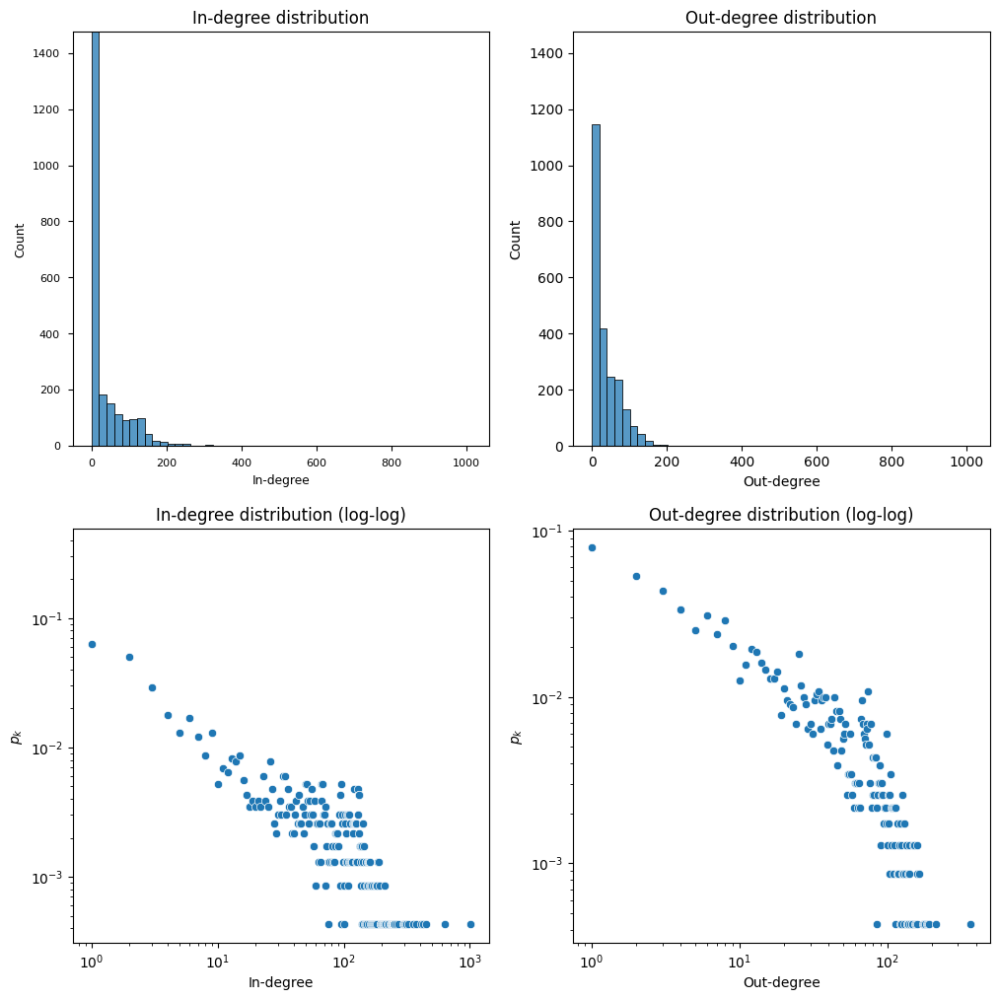

In [116]:
plot_in_and_out_degree_distribution(G)

#### Plotted degree distributions of powerful-people subgraph

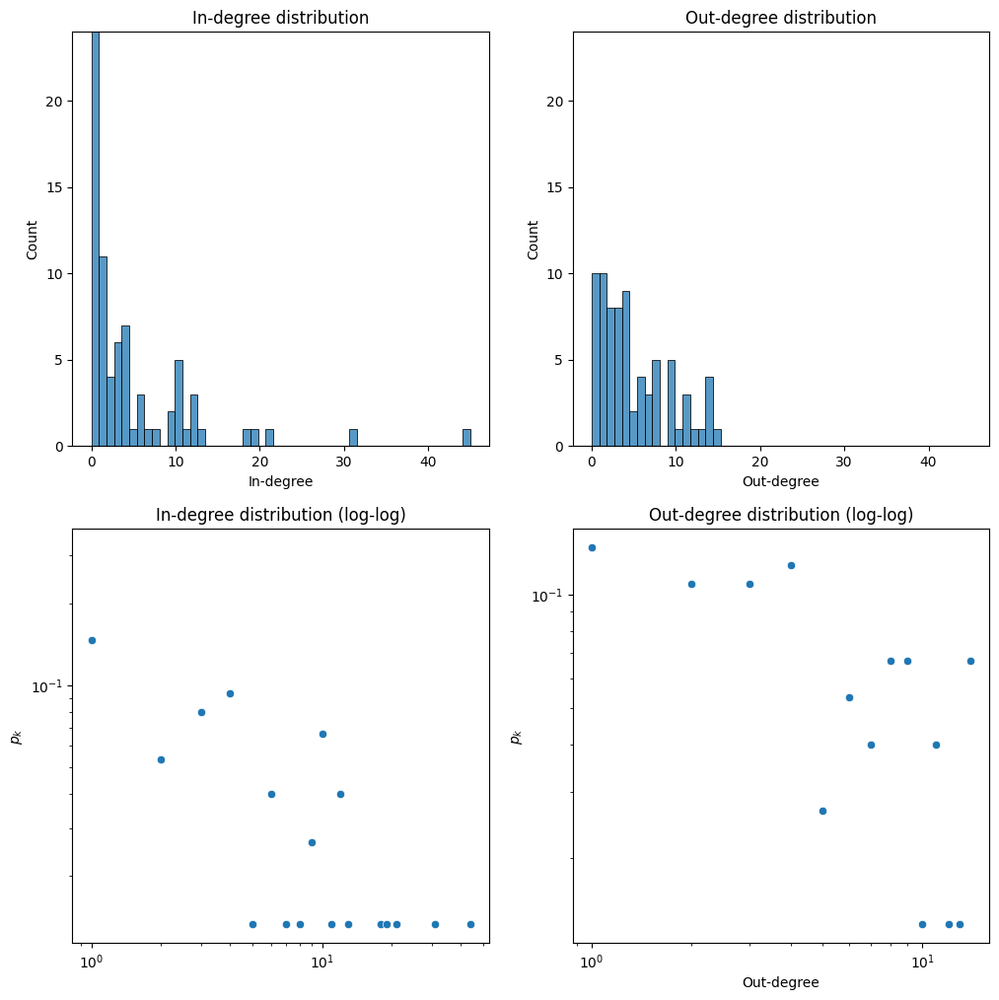

In [26]:
people_subgraph = G.subgraph([n for n in G.nodes() if G.nodes[n]["node_type"] == ATTRIBUTE_PEOPLE_TYPE])

plot_in_and_out_degree_distribution(people_subgraph)

In [27]:
l_max_people_subgraph = people_subgraph.number_of_nodes() * (people_subgraph.number_of_nodes() - 1)
l_people_subgraph = people_subgraph.number_of_edges()

print(f"L_max = {l_max_people_subgraph}")
print(f"L = {l_people_subgraph}")

L_max = 5550
L = 365


People subgraph is sparse, as $L << L_{max}$.

#### Plotted degree distributions of country subgraph

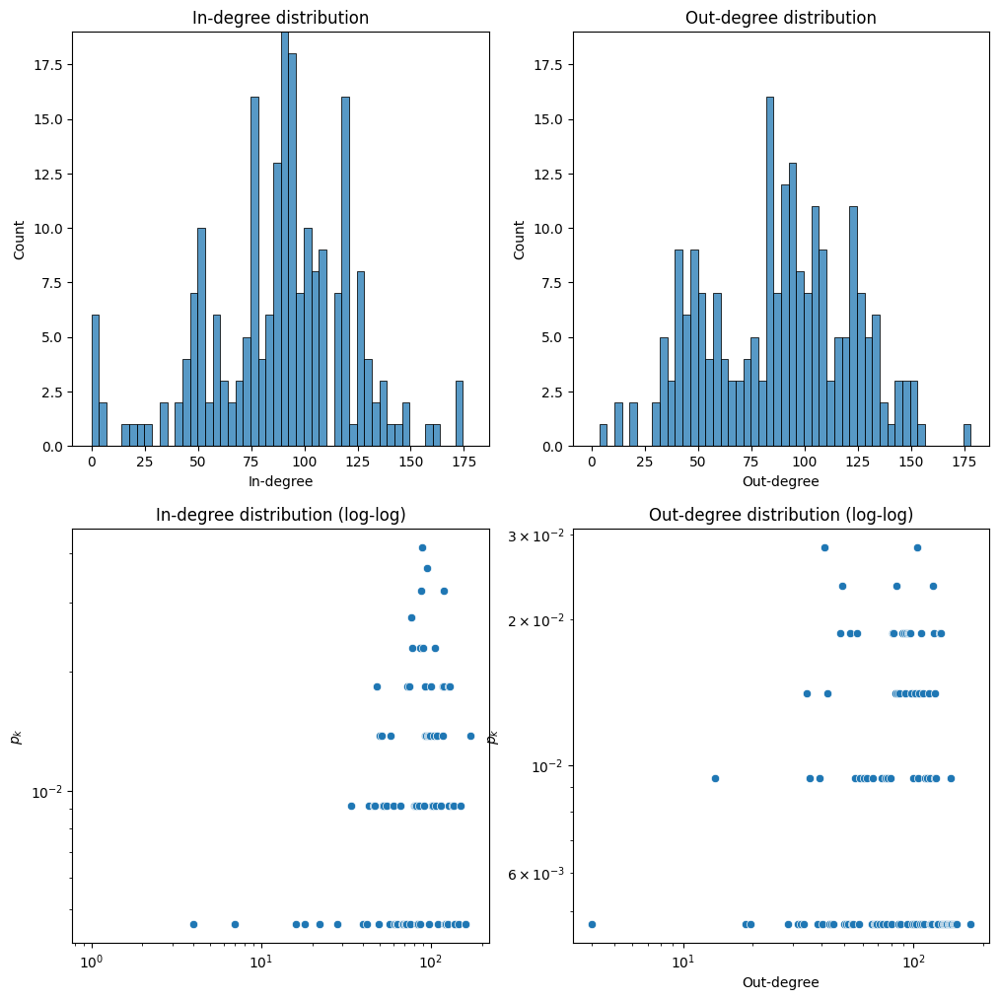

In [28]:
plot_in_and_out_degree_distribution(
    G.subgraph([n for n in G.nodes() if G.nodes[n]["node_type"] == ATTRIBUTE_COUNTRY_TYPE]))

#### Plotted degree distributions of organization subgraph

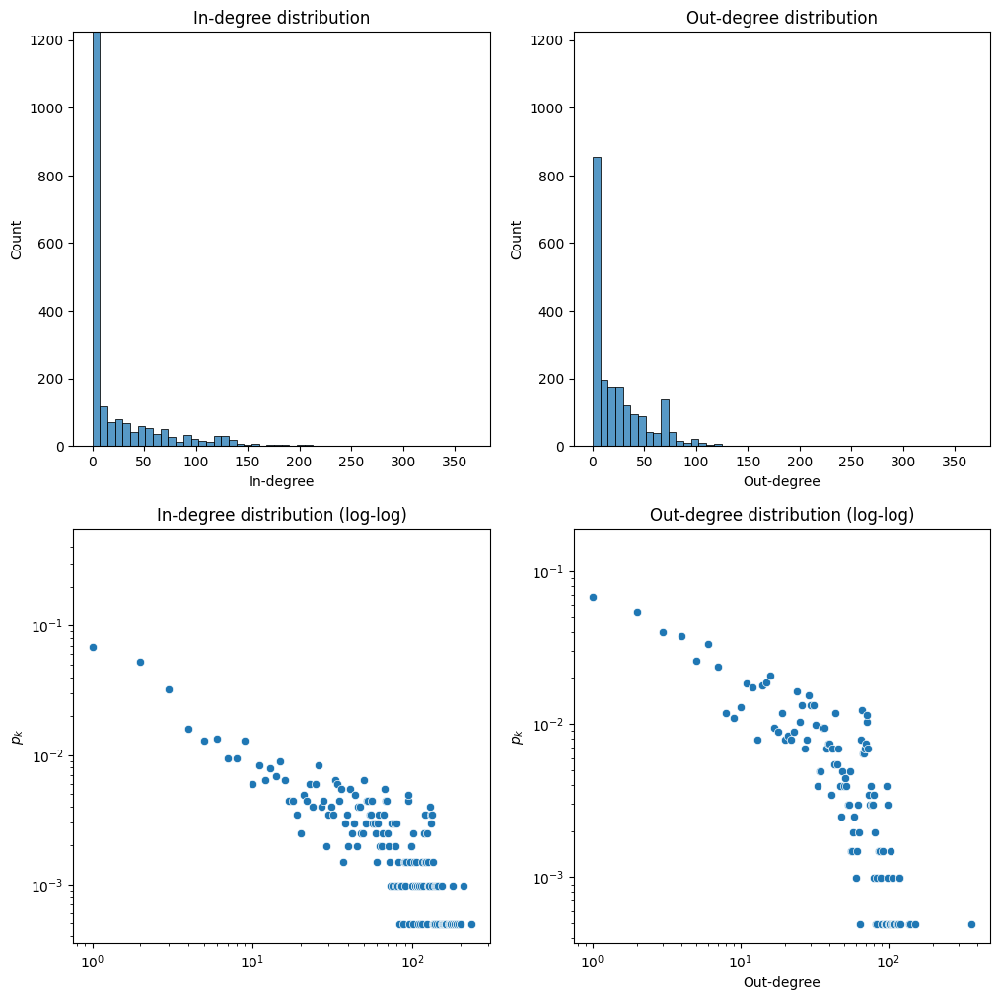

In [29]:
plot_in_and_out_degree_distribution(
    G.subgraph([n for n in G.nodes() if G.nodes[n]["node_type"] == ATTRIBUTE_ORGANIZATION_TYPE]))

#### Top 10 most connected people (in-/out-degree)

We retrieve the 10 people with the highest in-degrees, resp. out-degrees and display them in a dataframe.

In [30]:
# Get most connected powerful people

# Get top 5 nodes with highest in degree 
dfTop10Degree = pd.DataFrame()

GIDP = {n: G.in_degree(n) for n in G.nodes() if nx.get_node_attributes(G, 'node_type')[n] == 'person'}
# Get top 5 nodes with highest out degree
GODP = {n: G.out_degree(n) for n in G.nodes() if nx.get_node_attributes(G, 'node_type')[n] == 'person'}

dfTop10Degree["In-degree person"] = sorted(GIDP, key=GIDP.get, reverse=True)[:10]
dfTop10Degree["In-degree value"] = sorted(GIDP.values(), reverse=True)[:10]
dfTop10Degree["Out-degree person"] = sorted(GODP, key=GODP.get, reverse=True)[:10]
dfTop10Degree["Out-degree value"] = sorted(GODP.values(), reverse=True)[:10]
dfTop10Degree

,In-degree person,In-degree value,Out-degree person,Out-degree value
0,Donald Trump,114,Emmanuel Macron,211
1,Vladimir Putin,68,Recep Tayyip Erdogan,186
2,Xi Jinping,38,Xi Jinping,180
3,Narendra Modi,34,Vladimir Putin,176
4,Warren Buffett,31,Jokowi Widodo,175
5,Emmanuel Macron,27,Abdel Fattah el-Sisi,164
6,Bill Gates,21,Bashar al-Assad,164
7,Jeff Bezos,20,Kim Jong-un,159
8,Elon Musk,20,Ali Hoseini-Khamenei,158
9,Pope Francis,18,Justin Trudeau,109


In [31]:
top_10_in = set(dfTop10Degree["In-degree person"])
top_10_out = set(dfTop10Degree["Out-degree person"])

print("=== Top 10 connected people ===")
print(f"Only high in-degree: {top_10_in.difference(top_10_out)}")
print(f"Only high out-degree: {top_10_out.difference(top_10_in)}")
print(f"Both, high in- and out-degree: {top_10_in.intersection(top_10_out)}")

=== Top 10 connected people ===
Only high in-degree: {'Narendra Modi', 'Pope Francis', 'Elon Musk', 'Warren Buffett', 'Jeff Bezos', 'Donald Trump', 'Bill Gates'}
Only high out-degree: {'Abdel Fattah el-Sisi', 'Recep Tayyip Erdogan', 'Bashar al-Assad', 'Ali Hoseini-Khamenei', 'Justin Trudeau', 'Jokowi Widodo', 'Kim Jong-un'}
Both, high in- and out-degree: {'Xi Jinping', 'Vladimir Putin', 'Emmanuel Macron'}


### Most connected nodes (people, countries and organizations)

This shows the most connected nodes, which can be either people, countries or organizations.

In [32]:
dfTop10DegreeAll = pd.DataFrame()

IDdict = dict(G.in_degree()) # Get top 5 nodes with highest in degree
ODdict = dict(G.out_degree()) # Get top 5 nodes with highest out degree

dfTop10DegreeAll["In Degree"] = sorted(IDdict, key=IDdict.get, reverse=True)[:10]
dfTop10DegreeAll["Out Degree"] = sorted(ODdict, key=ODdict.get, reverse=True)[:10]
dfTop10DegreeAll

,In Degree,Out Degree
0,United States,Western Alliance Bancorp.
1,China,Emmanuel Macron
2,United Kingdom,Spotify Technology
3,Japan,France
4,Canada,Recep Tayyip Erdogan
5,India,Xi Jinping
6,France,Vladimir Putin
7,Australia,Jokowi Widodo
8,Hong Kong,Abdel Fattah el-Sisi
9,Germany,Bashar al-Assad


In [33]:
top_10_in = set(dfTop10DegreeAll["In Degree"])
top_10_out = set(dfTop10DegreeAll["Out Degree"])

print("=== Top 10 connected - All nodes ===")
print()
print(f"Only high in-degree: {top_10_in.difference(top_10_out)}")
print()
print(f"Only high out-degree: {top_10_out.difference(top_10_in)}")
print()
print(f"Both, high in- and out-degree: {top_10_in.intersection(top_10_out)}")

=== Top 10 connected - All nodes ===

Only high in-degree: {'Canada', 'India', 'China', 'Australia', 'Japan', 'United Kingdom', 'Hong Kong', 'Germany', 'United States'}

Only high out-degree: {'Abdel Fattah el-Sisi', 'Recep Tayyip Erdogan', 'Vladimir Putin', 'Xi Jinping', 'Emmanuel Macron', 'Spotify Technology', 'Bashar al-Assad', 'Jokowi Widodo', 'Western Alliance Bancorp.'}

Both, high in- and out-degree: {'France'}


### Correlation between ranking of powerful people and their degree

This shows the powerful people, with their power-rank, out- and in-degree.

In [34]:
p = get_powerful_people()
p = p[["name", "rank"]].set_index(["name"])

inDegree = pd.DataFrame.from_dict(GIDP,orient='index',columns=['In degree'])
outDegree = pd.DataFrame.from_dict(GODP,orient='index',columns=['Out degree'])

dfCorr = p.join(outDegree).join(inDegree)
dfCorr

,rank,Out degree,In degree
name,,,
Xi Jinping,1,180,38
Vladimir Putin,2,176,68
Donald Trump,3,25,114
Angela Merkel,4,43,15
Jeff Bezos,5,33,20
...,...,...,...
Reed Hastings,71,4,1
Robert Mueller,72,7,5
Abu Bakr al-Baghdadi,73,14,4


#### Compute correlation between degree and powerful-people-ranking

To find out if there is any correlation between the degree of person-node and their rank, we calculate the _Spearman's_ correlation value $\rho$ for in- and out-degrees.

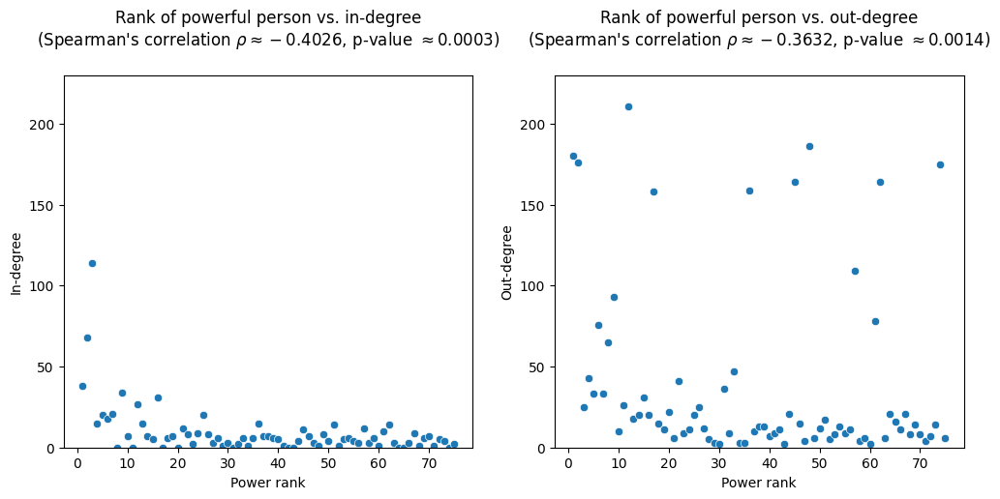

In [35]:
matplotlib.rc_file_defaults()

spearman_in = stats.spearmanr(dfCorr["rank"], dfCorr["In degree"])
spearman_out = stats.spearmanr(dfCorr["rank"], dfCorr["Out degree"])

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.title(f"""Rank of powerful person vs. in-degree
(Spearman's correlation $\\rho \\approx {spearman_in[0]:.4f}$, p-value $\\approx {spearman_in[1]:.4f}$)
""")
plt.xlabel("Power rank")
plt.ylabel("In-degree")
plt.ylim(top=230)
sns.scatterplot(x=dfCorr["rank"], y=dfCorr["In degree"])

plt.subplot(1, 2, 2)
plt.title(f"""Rank of powerful person vs. out-degree
(Spearman's correlation $\\rho \\approx {spearman_out[0]:.4f}$, p-value $\\approx {spearman_out[1]:.4f}$)
""")
plt.xlabel("Power rank")
plt.ylabel("Out-degree")
plt.ylim(top=230)
sns.scatterplot(x=dfCorr["rank"], y=dfCorr["Out degree"])

plt.show()

#### How many of the top 10 ranked people also are in top 10 connected with in- and outoing links?

The 7 people who are both within top 10 powerful people _and_ within top 10 of having in-going links **can be assumed to be the "famous" people of our network**.

In [36]:
top_10_in = dfCorr.sort_values("In degree", ascending=False).head(10)

print("Number of people in top 10 most ranked and top 10 most in going links: ",(top_10_in["rank"] <11).sum())
print()
print("Number of people in top 10 most ranked and top 10 most in going links: ",(top_10_in["rank"] <11).sum())
top_10_out = dfCorr.sort_values("Out degree", ascending=False).head(10)
print()
print("Number of people in top 10 most ranked and top 10 most outgoing links: ",(top_10_out["rank"] <11).sum())

Number of people in top 10 most ranked and top 10 most in going links:  7

Number of people in top 10 most ranked and top 10 most in going links:  7

Number of people in top 10 most ranked and top 10 most outgoing links:  2


### Centrality: 10 most central characters - visualized and values

In [37]:
import itertools

# Most central people according to degree centrality
def calculate_degree_centrality(graph: nx.Graph):
    degree_centralities = {k: v for k, v in sorted(nx.algorithms.degree_centrality(graph).items(), key=lambda item: item[1], reverse=True)}
    degree_centralities = {k: (v, G.nodes[k]["rank"]) for k, v in degree_centralities.items() if graph.nodes[k]["node_type"] == ATTRIBUTE_PEOPLE_TYPE}
    return degree_centralities


# Most central people according to betweenness centrality
def calculate_betweenness_centrality(graph: nx.Graph):
    betweenness_centrality = {k: v for k, v in sorted(nx.algorithms.betweenness_centrality(graph).items(), key=lambda item: item[1], reverse=True)}
    betweenness_centrality = {k: (v, G.nodes[k]["rank"]) for k, v in betweenness_centrality.items() if graph.nodes[k]["node_type"] == ATTRIBUTE_PEOPLE_TYPE}
    return betweenness_centrality


# Most central people according to eigenvector centrality (in-going edges)
def calculate_in_edges_eigenvector_centrality(graph: nx.Graph):
    eigenvector_centralities = {k: v for k, v in sorted(nx.algorithms.eigenvector_centrality(graph).items(), key=lambda item: item[1], reverse=True)}
    eigenvector_centralities = {k: (v, G.nodes[k]["rank"]) for k, v in eigenvector_centralities.items() if graph.nodes[k]["node_type"] == ATTRIBUTE_PEOPLE_TYPE}
    return eigenvector_centralities


# Most central people according to eigenvector centrality (out-going edges)
def calculate_out_edges_eigenvector_centrality(graph: nx.Graph):
    return calculate_in_edges_eigenvector_centrality(graph.reverse())


def get_first_n_of_dict(dictionary, n):
    return dict(itertools.islice(dictionary.items(), n))

In [38]:
degree_centrality = calculate_degree_centrality(G)

In [39]:
betweenness_centrality = calculate_betweenness_centrality(G)

In [40]:
eigenvector_centrality_in = calculate_in_edges_eigenvector_centrality(G)

In [41]:
eigenvector_centrality_out = calculate_out_edges_eigenvector_centrality(G)

In [42]:
from sklearn import preprocessing

def get_node_sizes(graph, centrality_dict):
    node_sizes = []

    centrality_dict = {k: v[0] for k, v in centrality_dict.items()}

    normalized_centralities = list(preprocessing.normalize([list(centrality_dict.values())])[0])

    # Replace centrality values with normalized ones
    for (k), (normalized_value) in zip(centrality_dict.keys(), normalized_centralities):
        centrality_dict[k] = normalized_value

    for node_name in graph.nodes():
        if node_name in centrality_dict:
            node_sizes.append(1 + (30 * centrality_dict[node_name]))
        else:
            node_sizes.append(1)

    return node_sizes


#### Degree centrality

In [43]:
print("Top 10 people nodes: Degree centrality and rank")
get_first_n_of_dict(degree_centrality, 10)

Top 10 people nodes: Degree centrality and rank


{'Vladimir Putin': (0.1053085886922745, 2),
 'Emmanuel Macron': (0.1027190332326284, 12),
 'Xi Jinping': (0.09408718170047475, 1),
 'Recep Tayyip Erdogan': (0.0807078118256366, 48),
 'Bashar al-Assad': (0.07682347863616745, 62),
 'Abdel Fattah el-Sisi': (0.0755287009063444, 45),
 'Jokowi Widodo': (0.0755287009063444, 74),
 'Kim Jong-un': (0.07509710832973673, 36),
 'Ali Hoseini-Khamenei': (0.06819162710401382, 17),
 'Donald Trump': (0.059991368148467845, 3)}

#### Betweenness centrality

* Measure of centrality based on shortest path (all pairs of nodes compared)
* Indicates to what degree a node stands between all others
[https://www.wikiwand.com/en/Betweenness_centrality]

* Indicates the probability "of occasions on which an individual [node] will sit on the shortest paths between other" nodes 
[[Social network analysis of medication advice-seeking interactions among staff in an Australian hospital]](https://www.sciencedirect.com/science/article/pii/S1386505608001512?casa_token=bwKznkE3AEsAAAAA:QzjhPalh-9pIqXJLkp-PgUd_8VBe2kc7d5ObNQ0afEvxUrKBEkL3Rv2xTxQlnRiHCH3SlkXwfbM)

In [44]:
print("Top 10 people nodes: Betweenness centrality and rank")
get_first_n_of_dict(betweenness_centrality, 10)

Top 10 people nodes: Betweenness centrality and rank


{'Donald Trump': (0.005486699684809935, 3),
 'Vladimir Putin': (0.0029234742530444974, 2),
 'Bill Gates': (0.0019051185257706598, 7),
 'Xi Jinping': (0.0015960364002563059, 1),
 'Warren Buffett': (0.0015381998465584972, 16),
 'Elon Musk': (0.0011448625858107172, 25),
 'Li Ka-shing': (0.0009475673236457124, 46),
 'Aliko Dangote': (0.0009380558633698045, 66),
 'Ma Huateng': (0.000907378099745402, 27),
 'Narendra Modi': (0.000906348333776375, 9)}

#### Eigenvector centrality

The eigenvector centrality is a **measure of the influence in the network**. A high value indicates a nodes is connected to many nodes that have high values themselves. [https://www.wikiwand.com/en/Eigenvector_centrality]

The following people seem to know (or are at least connected) to many people who themselves know many. That makes them influential.

However, the simple fact of having more outgoing links, creates a better eigenvector centrality. The following 10 people are almost identical in their order to the top 10 people with with outgoing links.

In [45]:
print("Top 10 people nodes: Eigenvector centrality (out-going links)")
get_first_n_of_dict(eigenvector_centrality_out, 10)

Top 10 people nodes: Eigenvector centrality (out-going links)


{'Emmanuel Macron': (0.12035992297444034, 12),
 'Recep Tayyip Erdogan': (0.10720255351630563, 48),
 'Xi Jinping': (0.1057174653462265, 1),
 'Jokowi Widodo': (0.10564414493925714, 74),
 'Vladimir Putin': (0.10423495860786952, 2),
 'Bashar al-Assad': (0.09951027915792868, 62),
 'Abdel Fattah el-Sisi': (0.09848477317307347, 45),
 'Ali Hoseini-Khamenei': (0.09637101616364879, 17),
 'Kim Jong-un': (0.09561790835191193, 36),
 'Justin Trudeau': (0.0661214844403519, 57)}

In [46]:
print("Top 10 people nodes: Eigenvector centrality (in-going links)")
get_first_n_of_dict(eigenvector_centrality_in, 10)

Top 10 people nodes: Eigenvector centrality (in-going links)


{'Vladimir Putin': (0.021389770024801656, 2),
 'Donald Trump': (0.012410576791906327, 3),
 'Narendra Modi': (0.008149228106486267, 9),
 'Xi Jinping': (0.006470769877883635, 1),
 'Bashar al-Assad': (0.003873405871988344, 62),
 'Kim Jong-un': (0.0036359057650577602, 36),
 'Emmanuel Macron': (0.003571665027151828, 12),
 'Pope Francis': (0.002118642050332108, 6),
 'Christine Lagarde': (0.0020000975200340915, 22),
 'Angela Merkel': (0.0018006736621315974, 4)}

In [47]:
centrality_data = pd.DataFrame({
    "degree_centrality": [a for (a,b) in sorted(degree_centrality.values(), key=lambda tup: tup[1])],
    "betweenness_centrality": [a for (a,b) in sorted(betweenness_centrality.values(), key=lambda tup: tup[1])],
    "eigenvector_centrality_in": [a for (a,b) in sorted(eigenvector_centrality_in.values(), key=lambda tup: tup[1])],
    "eigenvector_centrality_out": [a for (a,b) in sorted(eigenvector_centrality_out.values(), key=lambda tup: tup[1])],
})

Centrality values are plottet against the power rank of people. They don't seem to correlate. _Degree centrality_ and _eigenvector centrality (outgoing)_ have identical peaks.

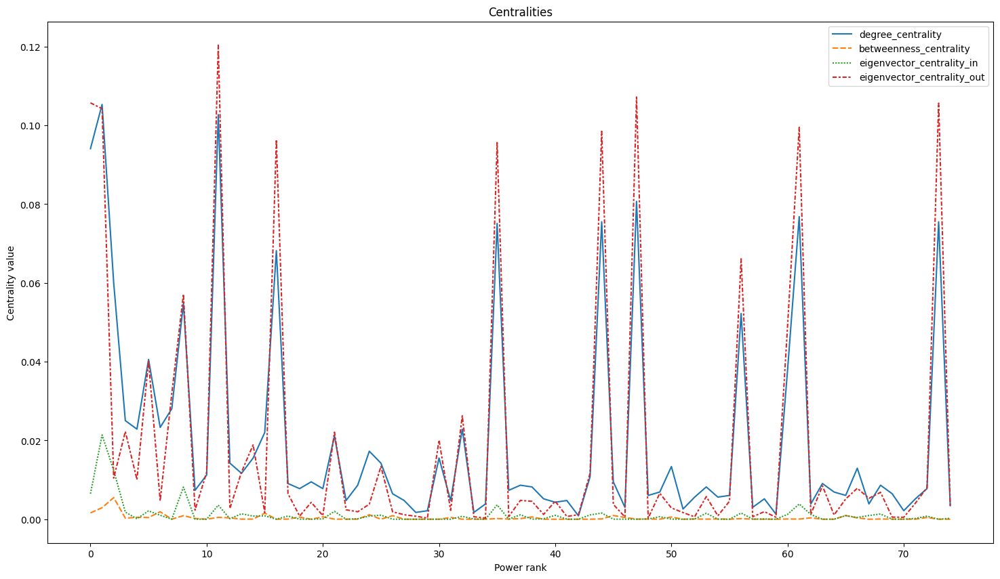

In [48]:
matplotlib.rc_file_defaults()
plt.figure(figsize=(18, 10))
plt.title("Centralities")
plt.xlabel("Power rank")
plt.ylabel("Centrality value")
sns.lineplot(data=centrality_data)
plt.show()

We take closer look at the centralities without seemingly random peaks: _Betweenness centrality_ and _Eigenvector centrality (ingoing)_. A lot of the values are very close to 0.

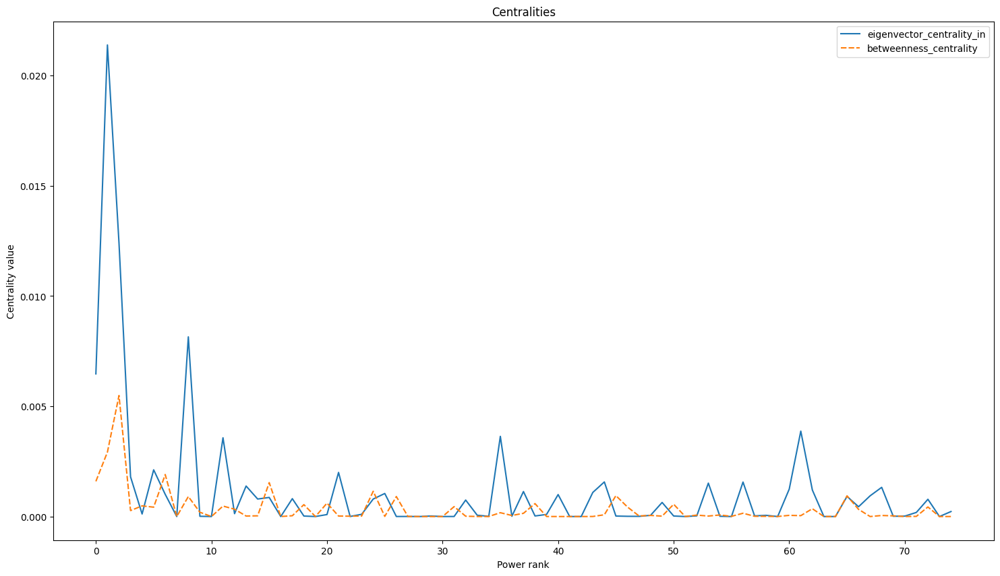

In [49]:
centrality_data = pd.DataFrame({
    "eigenvector_centrality_in": [a for (a,b) in sorted(eigenvector_centrality_in.values(), key=lambda tup: tup[1])],
    "betweenness_centrality": [a for (a,b) in sorted(betweenness_centrality.values(), key=lambda tup: tup[1])],
})
matplotlib.rc_file_defaults()
plt.figure(figsize=(18, 10))
plt.title("Centralities")
plt.xlabel("Power rank")
plt.ylabel("Centrality value")
sns.lineplot(data=centrality_data)
plt.show()

In [50]:
def get_all_possible_attributes(graph: nx.Graph) -> set:
    return set([item for sublist in [list(graph.nodes[n].keys()) for n in graph.nodes()] for item in sublist])

## Communities

In this section, communities are investigated.

First, the internal communities within the subgraph of each node type, i.e. *people*, *organisations* (companies) and *countries*, are found. Then, the nodes of countries and organisations respectively are (re)connected with the people nodes in *bipartite* networks using the original connections. When all this is done, one can compute the community distribution of neighbours for each powerful person and condense community nodes into community nodes for visualisation and further analysis.

Second, the same process is repeated but for the bipartite projections of people onto *countries* and *organisations* respectively.

It is especially interesting to investigate these communities due to the *famousness problem* of powerful people.


### Extracting subgraphs for countries, companies and people

The networks (subgraphs) of nodes for each node type is extracted from the original network (graph) using the following `extract_node_type_subgraph(G, node_type)` function. 

In [51]:
def extract_node_type_subgraph(G, node_type):
    # List all nodes of node type nodetype
    nodes = [n for n in G.nodes() if G.nodes[n]["node_type"] == node_type]
    # Create DiGraph as a copy of the extracted graph
    node_type_subgraph = nx.DiGraph(G.subgraph(nodes).copy())
    return node_type_subgraph, nodes

First, the people subgraph

In [52]:
people_subgraph, people_nodes = extract_node_type_subgraph(G, 'person')
print('The people subgraph was extracted including', people_subgraph.number_of_nodes(), 'nodes and', people_subgraph.number_of_edges(), 'edges')

The people subgraph was extracted including 75 nodes and 365 edges


Then, the country subgraph

In [53]:
country_subgraph, country_nodes = extract_node_type_subgraph(G, 'country')
print('The country subgraph was extracted including', country_subgraph.number_of_nodes(), 'nodes and', country_subgraph.number_of_edges(), 'edges')

The country subgraph was extracted including 218 nodes and 19208 edges


Finally, the organization subgraph

In [54]:
organization_subgraph, organization_nodes = extract_node_type_subgraph(G, 'organization')
print('The organization subgraph was extracted including', organization_subgraph.number_of_nodes(), 'nodes and', organization_subgraph.number_of_edges(), 'edges')

The organization subgraph was extracted including 2025 nodes and 47231 edges


The communities within each node type subgraph and the bipartite projections of people onto the remaining node types can now be found using the extracted subgraphs. 

### Finding communities within subgraphs/projections

Time to compute the communities within each subgraph (network of extracted subgraph). A few function has been written for this purpose and making reapeating the process easier when computing the communities within the birpatite projections later on.

The process for computing and drawing the communities for each subgraph is roughly described in the following steps.

* First, the subgraph is preprocessed for computing communities by converting the subgraph to an undirected graph and removing zero degree nodes.
* Next, the `community_louvain.best_partition()` function ([Python Louvain-algorithm](https://perso.crans.org/aynaud/communities/)) is used to compute communities.
* Finally, the subgraph is visualized and analysed.
    * The subgraph is drawn using spring_layout and Force Atlas 2 for node positions.
    * Nodes coloured dependent on their community partition.
    * The distribution of community sizes (node count) is plotted.
    * The modularity of the partitions is computed and shown.

The community partitions will used, in the next subsection, for connecting the people nodes to the communities of the country nodes and organization (company) nodes respectivly. 

First, the `preprocess_graph_for_community_detection(graph, min_degree)` function is defined for preprocessing each subgraph. First, the graph is convertet into a undirected graph then all zero degree nodes is removed as these won't be part of any meaningful partition or in other words would otherweise distort the partitions when using the Louvain algorithm.

In [55]:
def preprocess_graph_for_community_detection(graph, min_degree):
    undirected_subgraph = graph.to_undirected(graph) # Convert to undirected
    
    remove = [node for node, degree in dict(undirected_subgraph.degree()).items() if degree < min_degree]
    undirected_subgraph.remove_nodes_from(remove)
    
    undirected_subgraph = get_largest_connected_component(undirected_subgraph)

    return undirected_subgraph, remove

def get_largest_connected_component(graph):
    largest_cc = max(nx.connected_components(graph), key = len)
    lcc_subgraph = nx.Graph(graph.subgraph(largest_cc).copy(as_view = False))
    
    return lcc_subgraph

Next, a few functions is needed for node positioning and drawing of the community graphs in the `draw_communities(undirected_graph, partition, node_scale, **kwargs)` function below

In [56]:
def draw_communities(undirected_graph, partition, node_scale, **kwargs):
    # positions = community_layout(undirected_graph, partition)

    initial_positions = community_layout(undirected_graph, partition)
    positions = fa2_positions(undirected_graph, initial_positions)

    edge_alpha = 100 / (undirected_graph.number_of_edges() / 2)
    
    node_sizes = [degree * node_scale for node, degree in dict(undirected_graph.degree()).items()]

    nx.draw_networkx_nodes(
        undirected_graph, 
        positions, 
        node_size = node_sizes, 
        node_color = list(partition.values()),
        edgecolors = 'tab:gray',
        alpha = 0.9,
        **kwargs)
    nx.draw_networkx_edges(undirected_graph, positions, edge_color = 'grey', alpha = edge_alpha)
    
    plt.axis('off')
    plt.show()

The initial node positions is computed in the `community_layout(graph, partition)` below. 

First, all nodes within each community partition is positioned in a position for each community in the `position_communities(graph, partition, **kwargs)` function. Then, the nodes within each partition is positioned in `position_nodes(graph, partition, **kwargs)` function. Finally, the node positions is added to community positions. While the edges between communities is computed in the `get_between_community_edges(graph, partition)`.

In [57]:
def community_layout(graph, partition):
    
    communities_positions = position_communities(graph, partition, scale = 3.)
    
    node_positions = position_nodes(graph, partition, scale = 1.)

    final_positions = dict()
    for node in graph.nodes():
        final_positions[node] = communities_positions[node] + node_positions[node]

    return final_positions

def position_communities(graph, partition, **kwargs):
    between_community_edges = get_between_community_edges(graph, partition)
    
    # Create DiGraph of communities with weigthed edges
    communities = set(partition.values())
    community_graph = nx.DiGraph()
    community_graph.add_nodes_from(communities)
    for (ci, cj), edges in between_community_edges.items():
        community_graph.add_edge(ci, cj, weigth = len(edges))
    
    # Get positions for communities
    communities_positions = nx.spring_layout(community_graph, **kwargs)

    # Set node positions to positions of their community
    positions = dict()
    for node, community in partition.items():
        positions[node] = communities_positions[community]
    
    return positions

def get_between_community_edges(graph, partition):
    edges = dict()

    for (ni, nj) in graph.edges():
        ci = partition[ni]
        cj = partition[nj]

        if ci != cj:
            try:
                edges[(ci, cj)] += [(ni, nj)]
            except KeyError:
                edges[(ci, cj)] = [(ni, nj)]
    
    return edges

def position_nodes(graph, partition, **kwargs):
    communities = dict()
    for node, community in partition.items():
        try:
            communities[community] += [node]
        except KeyError:
            communities[community] = [node]
    
    positions = dict()
    for ci, nodes in communities.items():
        subgraph = graph.subgraph(nodes)
        subgraph_positions = nx.spring_layout(subgraph, **kwargs)
        # subgraph_positions = fa2_positions(subgraph)
        positions.update(subgraph_positions)
    
    return positions

In the above code, the `networkx.spring_layout()` is used for positioning of nodes. The code above does produce some, okay.., positions for visualizing the network where each community of nodes is distinct. However, a nicer visualization can be created by using these positions as *initial positions* in the ForceAtlas2 algorithm `pos` argument

In [58]:
def fa2_positions(undirected_graph, initial_positions = None):
    # Setup fa2 konfiguration
    communities_forceatlas2 = ForceAtlas2(
        # Behavior alternatives
        outboundAttractionDistribution = False, # Dissuade hubs: Distributes attraction along outbound edges. Hubs attract less and thus are pushed to the borders
        adjustSizes = False,
        edgeWeightInfluence=2.0,
    
        # Performance
        # How much swinging you allow. Above 1 discouraged. Lower gives less speed and more precision
        jitterTolerance = 1.0,
        # Barnes Hut optimization, n2 complexity to n.ln(n)
        barnesHutOptimize = True,
        barnesHutTheta = 1.2,

        # Tuning
        scalingRatio = 20,  # How much repulsion you want. More makes a more sparse graph
        strongGravityMode = False,  # A stronger gravity view
        gravity = 1.5,  # Attracts nodes to the center. Prevents islands from drifting away

        # Log
        verbose = SHOW_VERBOSE)
    
    # Compute positions
    positions = communities_forceatlas2.forceatlas2_networkx_layout(
        undirected_graph, 
        pos = initial_positions,
        iterations = 2000)
    
    return positions

The following function is used for plotting the distribution of the computed community partitions size in a herizontal bar chart. 

Where the y-axis denoting unique communities (partitions) and the x-axis denoting the count of nodes within each community.

In [59]:
def plot_community_distribution(ax, partition, cmap):
    uniques, counts = np.unique(np.array(list(partition.values())), return_counts = True)

    rescale = lambda y: (y - np.min(y)) / (np.max(y) - np.min(y))

    hbar = ax.barh(uniques, counts, color = cmap(rescale(uniques)), edgecolor = 'gray')
    ax.bar_label(hbar, counts, label_type = 'edge', padding = 2, fontsize = 8)
    ax.set_title('Distribution of community sizes', fontsize = 9)
    
    ax.set_xlabel('Count of nodes', fontsize = 8)
    
    ax.set_ylabel('Community (partition no.)', fontsize = 8)
    ax.set_yticks(uniques)

    ax.set_ylim((-1,20))

    plt.style.use('seaborn-paper')

Finally, a function for visuallizing the subgraphs with nodes coloured by community (partition) and plotting the community size distributions (with bars coloured in the same colores as the nodes).

Furthermore, both the number of excluded nodes (from community detection) and the modularity of the partition is computed and shown.

In [60]:
def community_analysis_visualizations(undirected_graph, partition, removed, color_scheme, title, node_scale):

    fig_community_analysis, (graph_ax, bar_ax) = plt.subplots(1, 2, figsize=(12,6), gridspec_kw={'width_ratios': [3, 1]})
    fig_community_analysis.tight_layout()
    fig_community_analysis.suptitle(title, fontsize = 11)
    
    _cmap = plt.cm.get_cmap(color_scheme)

    initial_positions = community_layout(undirected_graph, partition)
    positions = fa2_positions(undirected_graph, initial_positions)

    edge_alpha = 150 / (undirected_graph.number_of_edges() / 1.5) # Some graphs has a lot of edges
    
    node_sizes = [degree * node_scale for node, degree in dict(undirected_graph.degree()).items()]

    nx.draw_networkx_nodes(
        undirected_graph, 
        positions,
        node_size = node_sizes, 
        node_color = list(partition.values()),
        edgecolors = 'tab:gray',
        alpha = 0.9,
        cmap = _cmap,
        ax = graph_ax)
    nx.draw_networkx_edges(
        undirected_graph, 
        positions, 
        edge_color = EDGE_COLOR, 
        alpha = edge_alpha, 
        ax = graph_ax)
    
    graph_ax.axis('off')

    plot_community_distribution(bar_ax, partition, _cmap)

    # Add figure text with partition modularity
    modularity = community.modularity(partition, undirected_graph)
    _figure_text = f"""partition modularity: {modularity}
    number of excluded nodes: {len(removed)}"""

    fig_community_analysis.text(.5, .05, _figure_text, ha = 'center', fontsize = 8)

The internal community partitions for each subgraph can now be found using the following `find_internal_communties` function

In [61]:
def find_internal_communities(graph, color_scheme = "Greys", title = "Title", node_scale = 1):

    ## Preprocess graphs
    undirected_graph, removed = preprocess_graph_for_community_detection(graph, 1)
    print('Removed zero degree nodes:', removed)

    # First compute the best partition
    partition = community_louvain.best_partition(undirected_graph)

    # Set community as node attribute
    nx.set_node_attributes(undirected_graph, partition, 'community')

    community_analysis_visualizations(undirected_graph, partition, removed, color_scheme, title, node_scale)
    plt.show()

    return partition

First, the internal communities for the people nodes subgraph is found

Removed zero degree nodes: ['Aliko Dangote', 'Khalifa bin Zayed Al-Nahyan', 'Qamar Javed Bajwa', 'Akio Toyoda', 'Doug McMillon', 'Reed Hastings', 'Hui Ka Yan', 'Michael Dell', 'John L. Flannery', 'Jim Yong Kim']
100%|██████████| 2000/2000 [00:01<00:00, 1865.02it/s]
BarnesHut Approximation  took  0.17  seconds
Repulsion forces  took  0.41  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.12  seconds
AdjustSpeedAndApplyForces step  took  0.15  seconds


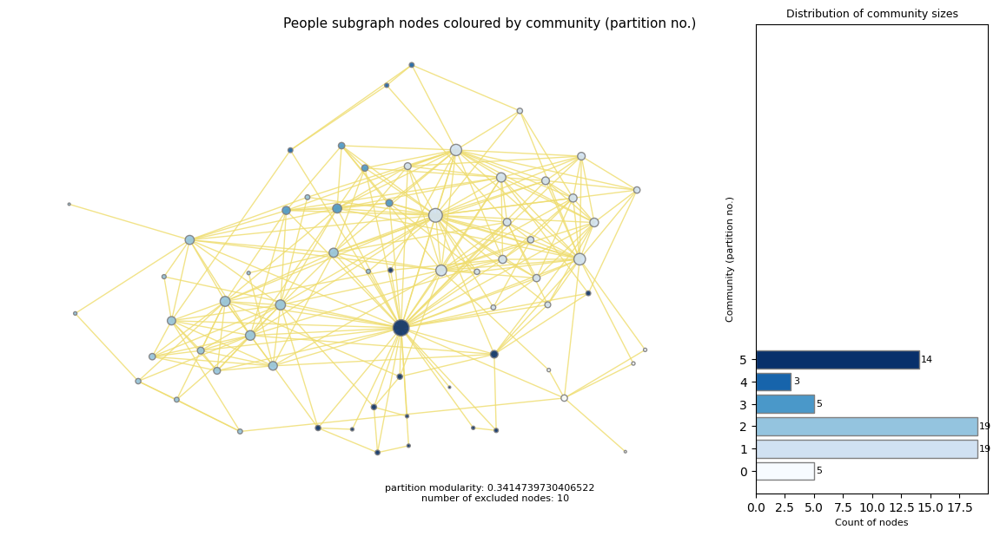

In [114]:
people_community_partition = find_internal_communities(
    people_subgraph, "Blues", 'People subgraph nodes coloured by community (partition no.)', 4)

The internal communities of the powerful people nodes subgraph is shown above. The computed modularity value is neither very low nor very high implying a suboptimal partition. It is interesting to see that 10 of the powerful people has been excluded from the community detection meaning almost one seventh of people nodes is zero-degree nodes with no links to or from other powerful people.

Next, the internal communities for the country nodes subgraph is found

Removed zero degree nodes: []
100%|██████████| 2000/2000 [00:03<00:00, 577.43it/s]
BarnesHut Approximation  took  1.02  seconds
Repulsion forces  took  0.92  seconds
Gravitational forces  took  0.03  seconds
Attraction forces  took  1.20  seconds
AdjustSpeedAndApplyForces step  took  0.12  seconds


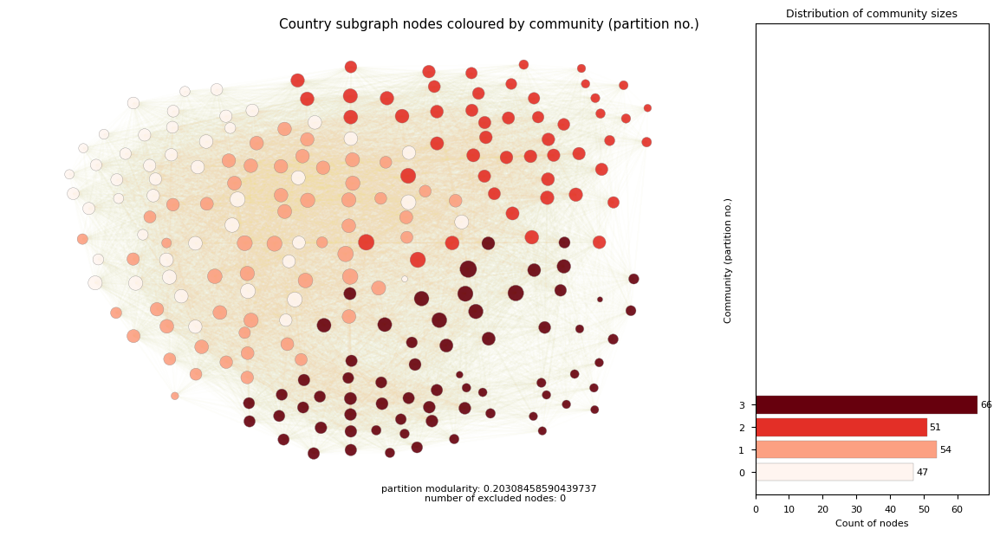

In [127]:
country_community_partition = find_internal_communities(
    country_subgraph, "Reds", 'Country subgraph nodes coloured by community (partition no.)')

The internal communities of the country nodes are shown above. As one might suspect, the computed modularity value is fairly low (even worse than the people partitions). Which implies a suboptimal partition according to the [Network Science Book Chapter 9.4](http://networksciencebook.com/chapter/9#modularity). Thus, failing to correctly identify the communities present in the network.
 
Furthermore, the distribution of country community size is somewhat even compared to the distribution of people community sizes and (spoiler) what we see later for the organization nodes. Yet another issue, running the community detection multiple times on the country nodes subgraph results in varying numbers of partitions (three to four) and varying number of nodes within each partition.
 
This might be due to the high number of edges (almost 20,000) with a relatively low number of nodes (218 nodes). While not a complete graph still this would make it difficult to detect communities within the network.

Last but definitely not least, the internal communities for the organization nodes is found

Removed zero degree nodes: ['Caterpillar', 'Danaher', 'Anglo American', 'Poly Developments & Holdings Group', 'Fresenius', 'Adobe', 'Sampo', 'Saudi Telecom', 'Greenland Holdings Group', 'Recruit Holdings ', 'Orsted', 'Williams', 'Thales', 'TE Connectivity', 'Eversource Energy', 'Formosa Petrochemical', 'Rongsheng Petrochemical', 'China Development Financial', 'Daqin Railway', 'Gemdale', 'George Weston', 'Fox', 'National Bank of Kuwait ', 'DSM', 'TCL ', 'Siam Cement', 'Huishang Bank', 'Whirlpool', 'Siemens Energy', 'WestRock', 'Westlake Chemical', 'Ball', "St. James's Place", 'Shin Kong Financial', 'Quinenco', 'Nomura', 'WR Berkley', 'Sika', 'Logan Property Holdings', 'AntarChile', 'VF', 'Jiangsu Zhongnan Construction Group', 'Korea Gas', 'Emaar Properties', 'Solvay', 'Molson Coors Brewing', 'Db Insurance', 'iA Financial Corporation', 'Antofagasta', 'Beijing Shougang', 'Hoya', 'Tongwei', 'China Longyuan Power', 'Beijing Enterprises', 'West Fraser Timber Co.', 'AES', 'Leonardo', 'Kingfis

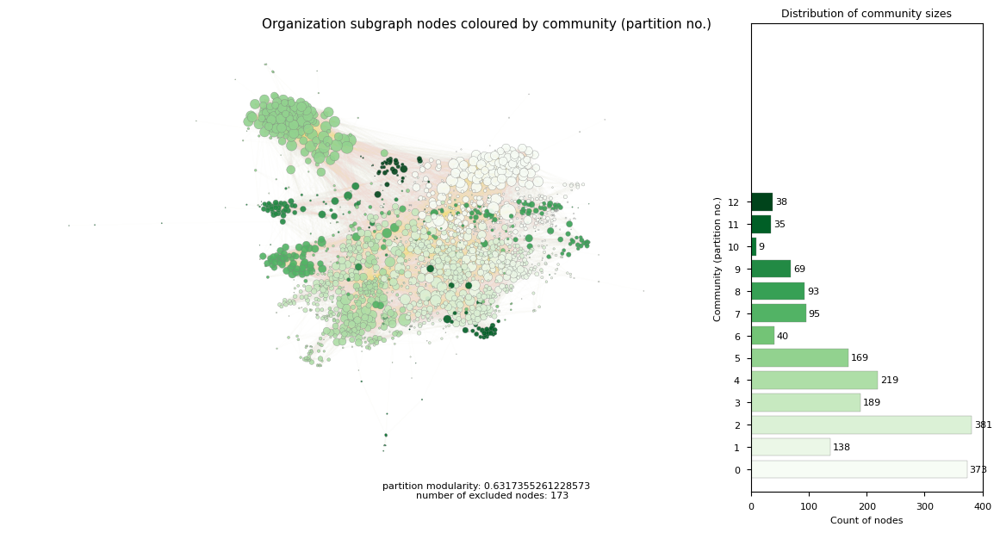

In [128]:
organization_community_partition = find_internal_communities(
    organization_subgraph, "Greens", 'Organization subgraph nodes coloured by community (partition no.)', 0.5)

The internal communities of the organization nodes are shown above. Eye-balling the visualization of the organization nodes, the grouping and node coloring already suggest a good partition of the nodes. The computed modularity value reinforces this as the modularity value is fairly high implying an optimal partition. Thus, closely matching the distinct communities.

In addition, the community size varies from a few communities consisting of many nodes to a few communities consisting of very few nodes while sizes in between much unlike the country distribution of community sizes.

### Connect powerful people to communities

It is finally time to connect the communities found with the powerful people nodes. Hopefully, we will learn if a powerful person is more likely to connect to some community than others or which communities they might influence more than others. Additionally, we might find where or how the most powerful people have their power.
 
The method for connecting the powerful people nodes to the communities found above is as follows:
 
* First, subgraphs of the people nodes and the country or organization nodes (companies) are created including their original nodes and edges (links). These original edges is needed for connecting the people nodes to communities of their neighboring country or organization nodes.
    * Furthermore, the number of nodes from each community which each person is connected to is counted - in order to learn which communities each powerful person is mostly connected to.
* Next, the nodes of each community are condensed into "super" community nodes whilst leaving the nodes which were removed/excluded during the preprocessing step (who thereby do not belong to any community) as gray nodes.
* Finally, the graph is visualized.

The `connect_node_types(G, a_nodes, b_nodes, b_partition)` function takes the "original" network, two lists of nodes (a and b fx. people nodes and country nodes) and the partition dict of the b nodes. The following function returns a subgraph of the a and b nodes

In [65]:
## Connect nodes of type a with nodes of type b and their community partition

def connect_node_types(G, a_nodes, b_nodes, b_partition):
    ab_graph = nx.Graph(G.subgraph(a_nodes + b_nodes).copy())

    # Set community as node attribute
    nx.set_node_attributes(ab_graph, b_partition, 'community')
    
    unique_partitions, partition_sizes = np.unique(np.array(list(b_partition.values())), return_counts = True)

    ## Compute lists of each person nodes': 
    # 1) neighbor communities
    # 2) neigbor fraction of communities
    # 3) higest fraction community
    
    connected_communities = []
    connected_nodes_fractions = []
    connected_community_highest_fraction = []
    # For each a_node (person) 
    for a_node in a_nodes:
        # Get partitions of neighboring nodes 
        b_neigbors_partitions = get_b_neighbors_partitions(ab_graph, a_node, b_nodes, b_partition)
        
        # Get the communities which the a_node connect to and count number of neigbors within each community
        unique_communities, connected_nodes = np.unique(np.array(b_neigbors_partitions), return_counts = True)

        # Compute fractions of community nodes connected to a_node
        computed_fractions = compute_fraction(unique_communities, connected_nodes, partition_sizes)
        
        # Find favorite community / higest connection fraction
        higest_fraction_community = get_community_max_fraction(computed_fractions, unique_communities)

        # Append to lists
        connected_communities.append(unique_communities)
        connected_nodes_fractions.append(computed_fractions)
        connected_community_highest_fraction.append(str(higest_fraction_community))

    # Create df from list of a_nodes, connected_communities and connected_nodes_fractions
    data = {
        'node' : a_nodes,
        'communities' : connected_communities,
        'fractions' : connected_nodes_fractions,
        'highest_fraction_community': connected_community_highest_fraction
    }

    df_neighbor_communities = pd.DataFrame(data)

    return ab_graph, df_neighbor_communities

def get_b_neighbors_partitions(ab_graph, a_node, b_nodes, b_partition):
    b_neigbors = [neighbor for neighbor in ab_graph.neighbors(a_node) if neighbor in b_nodes]
    b_neigbors_partitions = [value for key, value in b_partition.items() if key in b_neigbors]

    uniques, counts = np.unique(np.array(b_neigbors_partitions), return_counts = True)

    return b_neigbors_partitions

def get_community_max_fraction(computed_fractions, unique_communities):
    try:
        max_value = max(computed_fractions)
        max_index = computed_fractions.index(max_value)
        return unique_communities[max_index]
    except: # no fractions, no neighbors in communities :(
        return None

def compute_fraction(unique_communities, connected_nodes, partition_sizes):
    fractions = []
    for idx, community in enumerate(unique_communities):
        _fraction = connected_nodes[idx] / partition_sizes[community]
        fractions.append(_fraction)
    return fractions

# connect_node_types(G, people_nodes, country_nodes, country_community_partition)

Now the nodes of each community can be condensed / merged into the aforementioned "super" community nodes using the `condensed_communities(G, a_nodes, b_nodes, b_partition, **kwargs)` function

In [66]:
## Combine subgraphs with community nodes merge into "super community nodes"

def condense_communities(G, a_nodes, b_nodes, b_partition, **kwargs):
    # Create subgraph of subgraphs using the original graph
    ab_graph, df_neighbor_communities = connect_node_types(G, a_nodes, b_nodes, b_partition) # Use original connections

    unique_communities, sizes = np.unique(np.array(list(b_partition.values())), return_counts = True)
    for community in unique_communities:
        nodes = [node for node, value in b_partition.items() if value == community]
        merge_nodes(ab_graph, nodes, community, node_type = 'community', size = len(nodes), **kwargs)

    # Extract largest connect component for visualization
    largest_cc = max(nx.connected_components(ab_graph), key = len)
    ab_graph = nx.Graph(ab_graph.subgraph(largest_cc).copy(as_view = False))

    return ab_graph, df_neighbor_communities

def merge_nodes(graph, nodes, community_node, **attr):
    graph.add_node(community_node, **attr) # Add the community node to merge onto

    edges = graph.edges()
    for u, v in edges:
        try:
            if u in nodes:
                graph.add_edge(community_node, v)
            elif v in nodes:
                graph.add_edge(u, community_node)
        except KeyError:
            print(KeyError)

    # Then remove the merged nodes
    for n in nodes: 
        if graph.has_node(n):
            try:
                graph.remove_node(n)
            except KeyError:
                print(KeyError)

Finally, the graphs of powerful people connected to the condensed community nodes can be visualized.

In [67]:
def plot_community_graph(
    graph, people_nodes, 
    community_nodes, 
    partition, 
    node_scale = 1, 
    community_color = COUNTRY_COLOR, 
    title = 'The largest connected component of people and condensed communities',
    figure_text = ''):
    """
    This function calls the condense_communities in order to condense the nodes of each 
    community into condensed "super" community nodes. Then the graph is visuallized.

    Parameters
    ----------
    graph: The entire network
    people_nodes: Nodes to be connected to the communities
    community_nodes: E.g. country_nodes
    partition: dict describing the communities
    node_scale: nodes are sized dependent on degree, this optional arg scale alle nodes
    community_color: Color for the community nodes
    """
    
    ab_condensed_graph, df_neighbor_communities = condense_communities(G, people_nodes, community_nodes, partition)

    positions = fa2_positions(ab_condensed_graph)

    edge_alpha = 100 / (ab_condensed_graph.number_of_edges() / 2)

    node_sizes = [degree * node_scale for node, degree in dict(ab_condensed_graph.degree()).items()]

    fig_w_condensed_community_nodes = plt.figure(1, figsize=(12, 6))
    fig_w_condensed_community_nodes.suptitle(title, fontsize = 9)
    nx.draw_networkx_nodes(
        ab_condensed_graph, 
        positions, 
        node_size = node_sizes,
        #node_size = 20,
        node_color = map_colors(ab_condensed_graph, community_color))
    nx.draw_networkx_edges(ab_condensed_graph, positions, edge_color = EDGE_COLOR, alpha = edge_alpha)

    # Add legend
    communities_patch = mpatches.Patch(color=community_color, label='condensed communities')
    people_patch = mpatches.Patch(color=PEOPLE_COLOR, label="powerful people")
    grey_patch = mpatches.Patch(color=GREY_COLOR, label="nodes not in communities")
    plt.legend(handles=[communities_patch, people_patch, grey_patch], prop={'size': 6})

    # Add figure text
    fig_w_condensed_community_nodes.text(.5, .05, figure_text, ha = 'center', fontsize = 8)

    plt.axis('off')
    plt.show()

    return df_neighbor_communities

def map_colors(graph, community_color):
    node_colors = []

    for node_name in graph.nodes:
        node_type = graph.nodes[node_name]['node_type']
        if node_type == "person":
            node_colors.append(PEOPLE_COLOR)
        elif node_type == "community":
            node_colors.append(community_color) # COUNTRY_COLOR or ORGANIZATION_COLOR
        else:
            node_colors.append(GREY_COLOR)

    return node_colors
    

First, let's take a look at how the powerful people connect to the country communities

100%|██████████| 2000/2000 [00:00<00:00, 3723.31it/s]
BarnesHut Approximation  took  0.13  seconds
Repulsion forces  took  0.26  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.05  seconds
AdjustSpeedAndApplyForces step  took  0.04  seconds


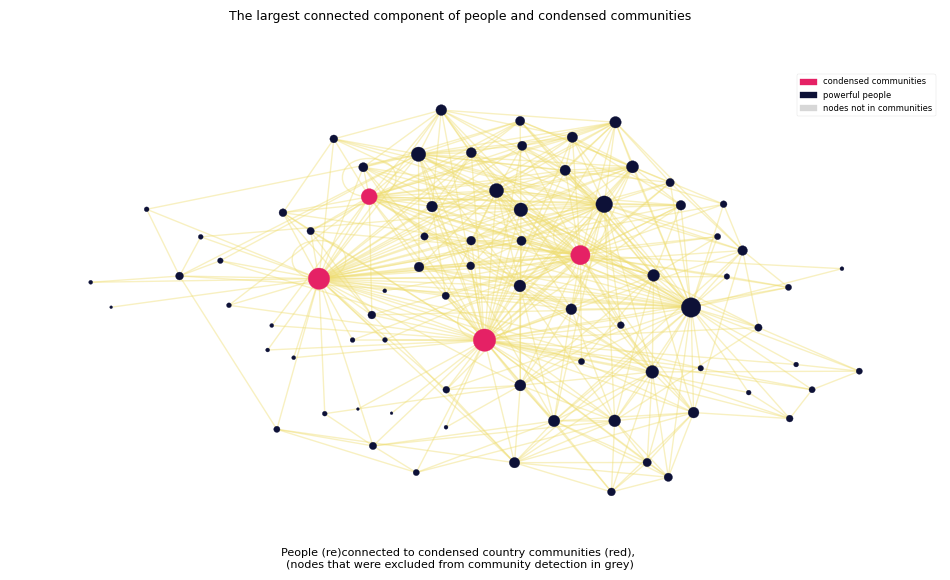

In [68]:
_figure_text = """People (re)connected to condensed country communities (red), 
(nodes that were excluded from community detection in grey)"""

df_people_n_country = plot_community_graph(
    G, 
    people_nodes, 
    country_nodes, 
    country_community_partition, 
    4, 
    COUNTRY_COLOR,
    figure_text = _figure_text)

The graph above shows the powerful people nodes in (dark) blue and the condensed country communities in red. Furthermore the links (edges) between people and other people as well as the links to the condensed communities. Where the node size is the node (undirected) degree. 
 
One might be tempted to use the degree as a measure for how likely a powerful person is to connect to a given community. However, even though the communities are not entirely similar in size (number of nodes). Which might result in the condensed community consisting of more nodes getting more connections.
 
Instead we compute which communities each person connects to the most, or prefer to connect to more than others, based on the fraction of nodes within a community each person is connected to - in other words, for each person the community with the highest fraction of connected nodes is found.
Finally, each unique preferred community is counted and plotted.

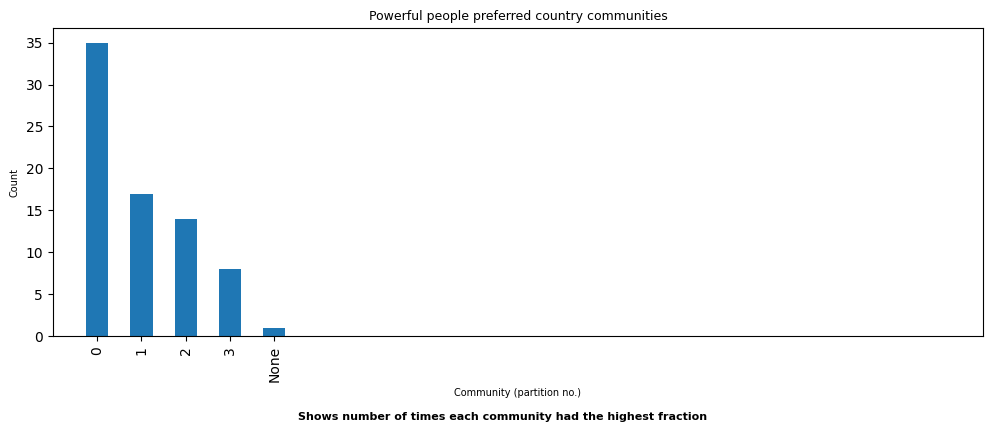

In [112]:
def plot_preferred_communities(df, title = 'Title'):
    matplotlib.rc_file_defaults()
    fig_highest_fraction_community = plt.figure(1, figsize=(12, 4))
    
    figure_text = 'Shows number of times each community had the highest fraction'
    fig_highest_fraction_community.text(.5, -.1, figure_text, ha = 'center', fontsize = 8, fontweight ='bold')

    ax = df['highest_fraction_community'].value_counts().plot(kind = 'bar')
    plt.title(title, fontsize = 9)
    plt.xlabel('Community (partition no.)', fontsize = 7)
    plt.ylabel('Count', fontsize = 7)
    plt.xlim(-1, 20)

plot_preferred_communities(df_people_n_country, 'Powerful people preferred country communities')

The bar chart above shows how many times each country community was preferred over other communities. Where “None” means that a person did not connect to any community. Here, it is interesting to see that a powerful person connects twice as often to community “0” than any other country community - with almost half of the powerful people connecting to community “0” the most.

Now lets take a look at which countries is in community "0"

In [70]:
preffered_country_community_nodes = [key for key, value in country_community_partition.items() if value == 0]
preffered_country_community_nodes

['Iran',
 'Cambodia',
 'North Korea',
 'Iraq',
 'Oman',
 'Laos',
 'Macau',
 'Tajikistan',
 'Nepal',
 'Philippines',
 'Bhutan',
 'Brunei',
 'Mongolia',
 'Ireland',
 'East Timor',
 'Uzbekistan',
 'Thailand',
 'Israel',
 'Egypt',
 'Bangladesh',
 'Japan',
 'United Arab Emirates',
 'Syria',
 'Jordan',
 'Myanmar',
 'Hong Kong',
 'Lebanon',
 'Qatar',
 'Taiwan',
 'Maldives',
 'Vietnam',
 'Saudi Arabia',
 'India',
 'South Korea',
 'China',
 'Bahrain',
 'Indonesia',
 'Singapore',
 'Malaysia',
 'Sri Lanka',
 'Afghanistan',
 'Kuwait',
 'Kyrgyzstan',
 'Pakistan',
 'Yemen',
 'Palestine',
 'Turkmenistan']

Interestingly enough there aren't many western or european countries among the nodes of community "0". Instead, amongst mostly "minor" eastern, asian and pacific countries (many with a not so democratic reputation) three countries stick out the names China, India, Hong Kong (Administrative Region of China) and Japan. All three countries are also amongst the top 10 of all nodes including people and organizations with highest in-degree - China having second highest in-degree after USA, Japan in fourth, India in sixth and Hong Kong in eighth place.

Next, lets take a look on how the powerful people connect to company communities (organization communities)

100%|██████████| 2000/2000 [00:00<00:00, 2563.86it/s]
BarnesHut Approximation  took  0.17  seconds
Repulsion forces  took  0.41  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.06  seconds
AdjustSpeedAndApplyForces step  took  0.06  seconds


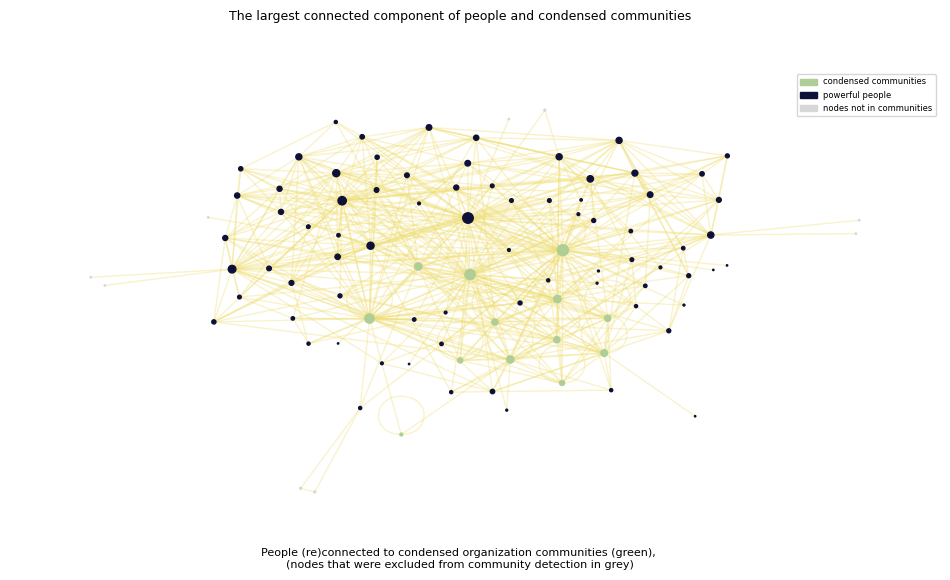

In [130]:
_figure_text = """People (re)connected to condensed organization communities (green), 
(nodes that were excluded from community detection in grey)"""

df_people_n_org = plot_community_graph(
    G, 
    people_nodes, 
    organization_nodes, 
    organization_community_partition, 
    1, 
    ORGANIZATION_COLOR,
    figure_text = _figure_text)

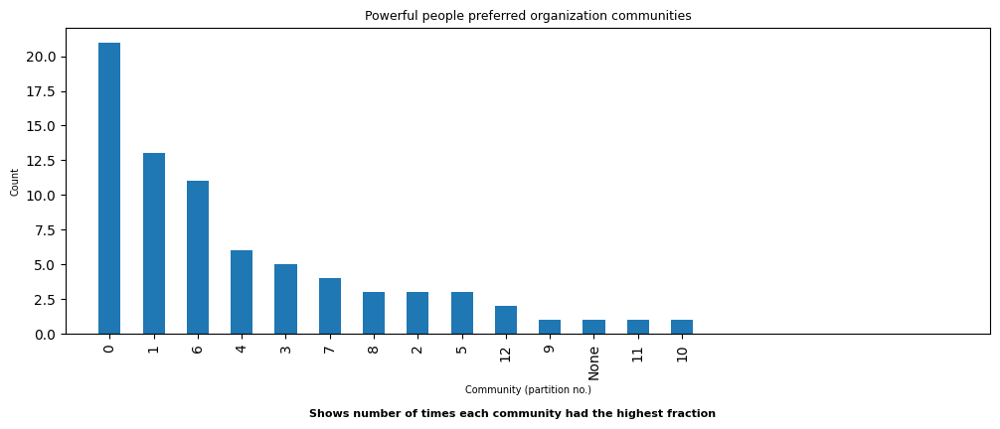

In [129]:
plot_preferred_communities(df_people_n_org, 'Powerful people preferred organization communities')

The bar chart above shows how many times each organization community was preferred over other communities. Where “None” means that a person did not connect to any community. Again, it is interesting to see that a powerful person connects twice as often to community “0” than any other organization community. However, this time the most “preferred” community only accounts for between one fourth and one third of the count.

Again let's investigate which organizations (mostly companies) is part of the organization nodes community "0"

In [131]:
preffered_org_community_nodes = [key for key, value in organization_community_partition.items() if value == 0]
preffered_org_community_nodes

['Amazon.com',
 'Bill & Melinda Gates Foundation',
 'Facebook',
 'Wal-Mart Stores',
 'Apple Inc.',
 'Tesla',
 'General Electric',
 'Koch Industries',
 'News Corp',
 'Microsoft',
 'Baidu',
 'Dell',
 'Amazon',
 'Apple',
 'Walmart',
 'Comcast',
 'Meta Platforms',
 'Johnson & Johnson',
 'CVS Health',
 'Intel',
 'Taiwan Semiconductor',
 'The Home Depot',
 'American Express',
 'PepsiCo',
 'Merck & Co.',
 'Elevance Health',
 'Cisco Systems',
 'Chubb',
 'IBM',
 'United Parcel Service',
 'Bristol Myers Squibb',
 'Oracle',
 'Costco Wholesale',
 'Charter Communications',
 'Visa',
 'Target',
 'tesla',
 "Lowe's",
 'FedEx',
 'Broadcom',
 'Medtronic',
 'Duke Energy',
 'Dell Technologies',
 'Honeywell International',
 'Micron Technology',
 'HCA Healthcare',
 'Dow',
 'Qualcomm',
 'Gilead Sciences',
 'NVIDIA',
 'Amgen',
 'Union Pacific',
 'Nike',
 'PayPal',
 'Travelers',
 'Eli Lilly',
 'Mondelez International',
 '3M',
 'Southern Company',
 'Netflix',
 'Exelon',
 'KKR',
 'NextEra Energy',
 'HP',
 'Salesf

The organisation nodes (companies) of community "0" is listed above. Here, it is seen that this particular community mainly consists of the world's most valuable tech/software companies as well as some of the most valuable companies within retail and finance/banking, most of which are US companies.

### Create projections from subpartite graphs

In order to learn something about communities of countries/organizations **depending on their connections to people**, we treat our graph as a _bipartite network_. To do so, we look at either _people and countries_ or _people and organizations_, and then at the projections of countries, resp. organizations.

_E.g._: Given _people and countries_, we will end up with a projection of countries. Countries _c1_ and _c2_ would be connected in the projected graph  if _c1_ was connected to person _p1_ and _p1_ was connected to _c2_.

This is achieved by the following steps:

* Create undirected subgraphs of _people & countries_ and _people & organizations_.
* Mark _people_ with `bipartite=0` and other nodes with `bipartite=1`.
* Remove interconnections between _people_ and the corresponding other nodes.
* Create projections of _country network_ and _organization network_.
* Find communities in those projections.


In [74]:
def get_nodes_of_type(graph, node_type):
    """
    Returns a list of nodes if their attribute "node_type" matches the provided node_type.
    """
    return [n for n in graph.nodes() if graph.nodes[n]["node_type"] == node_type]

In [75]:
country_nodes = get_nodes_of_type(G, ATTRIBUTE_COUNTRY_TYPE)
organization_nodes = get_nodes_of_type(G, ATTRIBUTE_ORGANIZATION_TYPE)
people_nodes = get_nodes_of_type(G, ATTRIBUTE_PEOPLE_TYPE)

In [76]:
# Create subpartite projections

from networkx.algorithms import bipartite

def create_bipartite_projection(overall_graph, projection_nodes, projection_node_type):
    # Copy original graph
    B = nx.DiGraph(overall_graph)
    # Create subgraph containing only countries & people 
    B = B.subgraph(people_nodes + projection_nodes)

    for node in B.nodes():
        if B.nodes[node]["node_type"] == projection_node_type:
            B.nodes[node]["bipartite"] = 1
        else:
            B.nodes[node]["bipartite"] = 0

    B = B.to_undirected()

    edges_to_remove = []
    for (u, v) in B.edges():
        node_type = B.nodes[u]["node_type"]
        if B.nodes[v]["node_type"] == node_type:
            edges_to_remove.append((u, v))
    B.remove_edges_from(edges_to_remove)

    return bipartite.projected_graph(B, projection_nodes)

#print(bipartite.is_bipartite(B))

#plot_graph(bipartite_country_graph)

#bipartite_country_graph.nodes()

#for n in bipartite_country_graph.nodes():
#    if "node_type" not in bipartite_country_graph.nodes[n]:
#        print(n)



In [77]:
country_bipartite_projection = create_bipartite_projection(G, country_nodes, ATTRIBUTE_COUNTRY_TYPE)
organization_bipartite_projection = create_bipartite_projection(G, organization_nodes, ATTRIBUTE_ORGANIZATION_TYPE)

Removed zero degree nodes: ['Ireland', 'Puerto Rico', 'DR Congo', 'Georgia', 'Congo', 'Guam', 'Greenland', 'Curaçao', 'Gambia', 'Zanzibar', 'Northern Mariana Islands', 'Turks and Caicos Islands', 'Sint Maarten', 'Micronesia', 'Anguilla', 'Montserrat']
100%|██████████| 2000/2000 [00:04<00:00, 477.43it/s]
BarnesHut Approximation  took  0.84  seconds
Repulsion forces  took  1.02  seconds
Gravitational forces  took  0.02  seconds
Attraction forces  took  2.01  seconds
AdjustSpeedAndApplyForces step  took  0.12  seconds


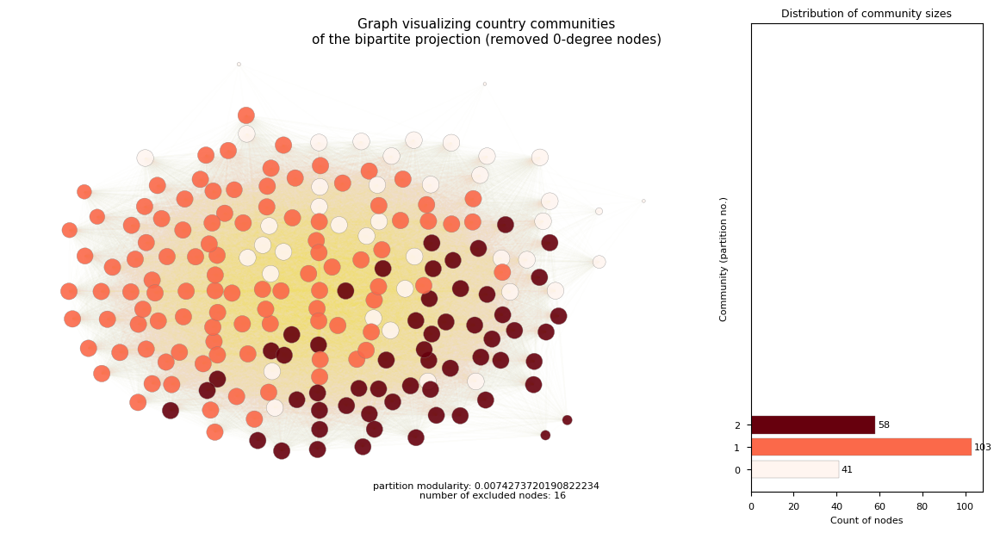

In [78]:
country_bipartite_community_partition = find_internal_communities(country_bipartite_projection, "Reds", 'Graph visualizing country communities\nof the bipartite projection (removed 0-degree nodes)')

Removed zero degree nodes: ['Toyota Motor', 'Fidelity Investments', 'ICBC', 'Saudi Arabian Oil Company (Saudi Aramco)', 'China Construction Bank', 'Agricultural Bank of China', 'Shell', 'Ping An Insurance Group', 'Verizon Communications', 'UnitedHealth Group', 'China Merchants Bank', 'Volkswagen Group', 'Chevron', 'Total', 'Postal Savings Bank Of China (PSBC)', 'Allianz', 'Johnson & Johnson', 'Mercedes-Benz Group', 'CVS Health', 'Sinopec', 'RBC', 'AXA Group', 'TD Bank Group', 'Nippon Telegraph & Tel', 'Industrial Bank ', 'Sony', 'Santander', 'Mitsubishi UFJ Financial', 'Taiwan Semiconductor', 'Bank of Communications', 'Procter & Gamble', 'BMW Group', 'AbbVie', 'Novartis', 'Equinor', 'China Life Insurance', 'Roche Holding', 'AIA Group', 'MetLife', 'BHP Group', 'The Home Depot', 'Zurich Insurance Group', 'Rio Tinto', 'Cigna', 'PepsiCo', 'Merck & Co.', 'Elevance Health', 'Bank of Nova Scotia', 'American International Group', 'Glencore International', 'Cisco Systems', 'Anheuser-Busch InBev

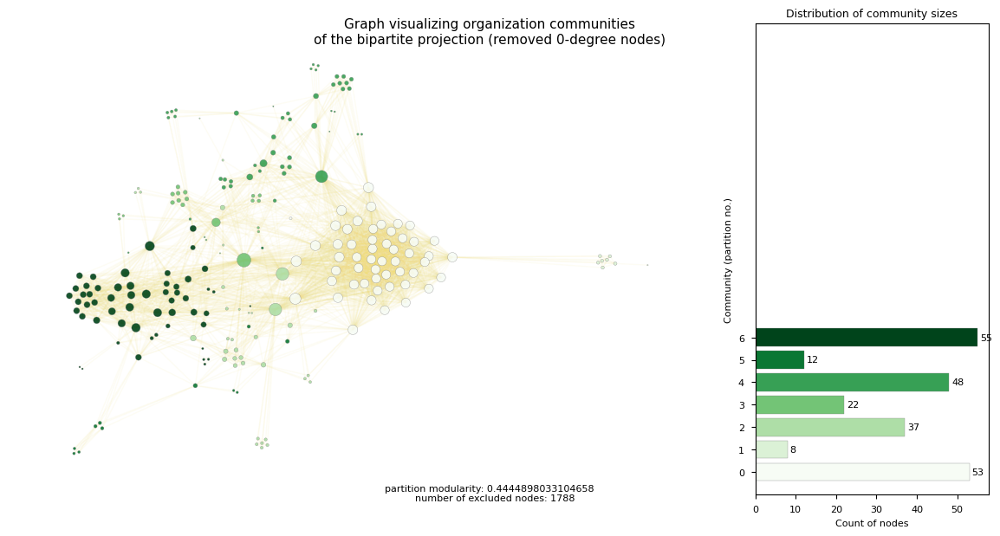

In [79]:
organization_bipartite_community_partition = find_internal_communities(organization_bipartite_projection, "Greens", 'Graph visualizing organization communities\nof the bipartite projection (removed 0-degree nodes)')

In [80]:
# Reconnect people

100%|██████████| 2000/2000 [00:00<00:00, 2951.42it/s]
BarnesHut Approximation  took  0.17  seconds
Repulsion forces  took  0.32  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.06  seconds
AdjustSpeedAndApplyForces step  took  0.06  seconds


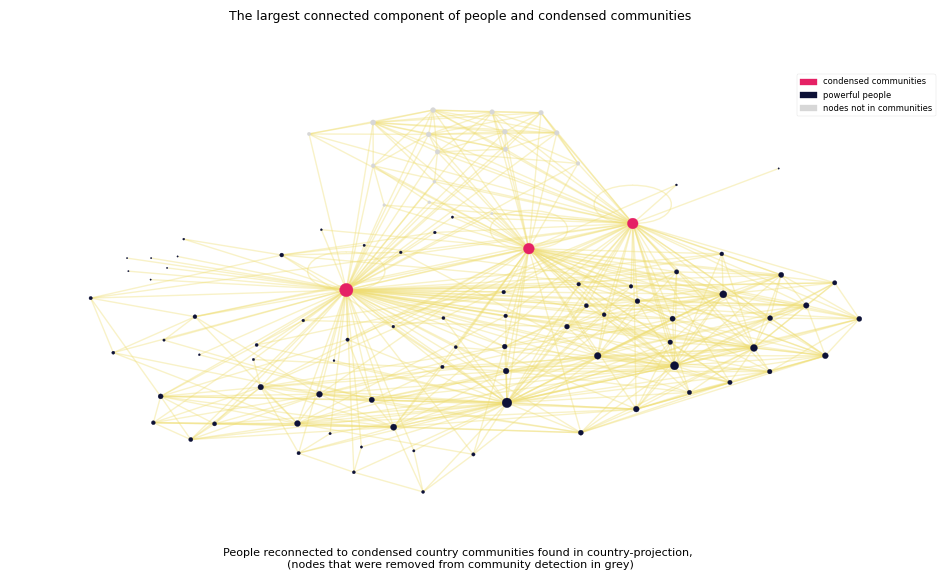

In [81]:
_figure_text = """People reconnected to condensed country communities found in country-projection, 
(nodes that were removed from community detection in grey)"""

df_people_n_bipartite_country_commu = plot_community_graph(
    G, 
    people_nodes, 
    country_nodes, 
    country_bipartite_community_partition, 
    1, 
    COUNTRY_COLOR,
    figure_text = _figure_text 
)

100%|██████████| 2000/2000 [00:56<00:00, 35.53it/s]
BarnesHut Approximation  took  25.05  seconds
Repulsion forces  took  25.69  seconds
Gravitational forces  took  0.20  seconds
Attraction forces  took  3.03  seconds
AdjustSpeedAndApplyForces step  took  0.92  seconds


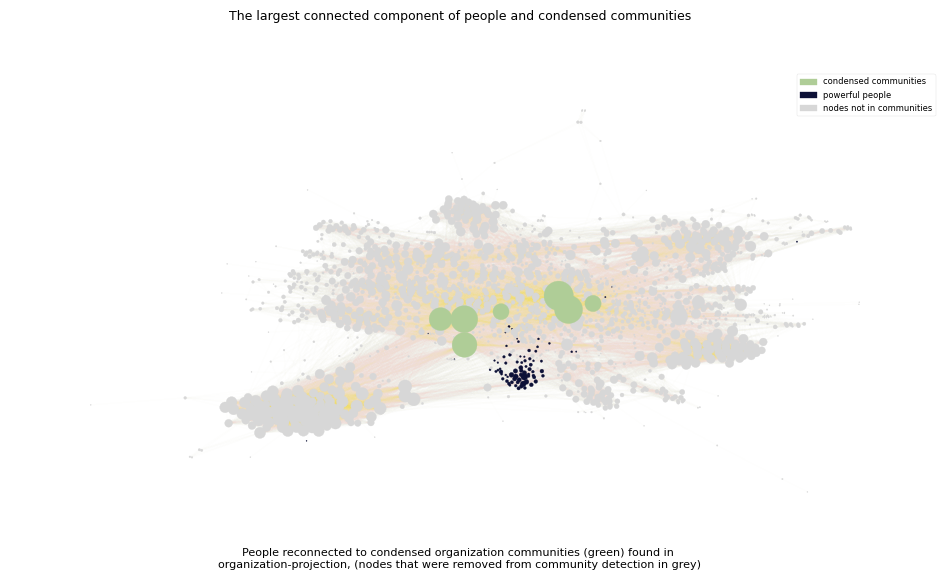

In [82]:
_figure_text = """People reconnected to condensed organization communities (green) found in 
organization-projection, (nodes that were removed from community detection in grey)"""

df_people_n_bipartite_org_commu = plot_community_graph(
    G, 
    people_nodes, 
    organization_nodes, 
    organization_bipartite_community_partition, 
    0.5, 
    ORGANIZATION_COLOR,
    figure_text = _figure_text)

## TF-IDFs

Here we will compute the TF-IDFs vectors for each person and their closest network (connected directly).  

### Functions

Here we define the functions which we use for computing the TF-IDF vectors

In [83]:
def merge_documents(edges):
    """Merges wiki content from nodes mentioned in edges

    Parameters
    ----------
    edges : list of tuples or str
        Is either a list of tuples which contains the edges of the small network. 
        Or it contains a string, which will be the case if we only want to return the wiki 
        content for a single node.

    Returns
    -------
    str
        a string containing all merged wiki content
    """

    if all(isinstance(e,tuple) for e in edges): # if list of tuples
        out = list(itertools.chain(*edges)) # From links to list
    elif isinstance(edges, str): # if dictionary with edges
        out = [edges] # From links to list
    else: 
        print("Passed edges is in in wrong format")
        
    names = np.unique(out) # Get unique names

    # Get subgraph of persons small network
    subG = G.subgraph(names).to_undirected()
    wiki = nx.get_node_attributes(subG, 'wiki_content') # Get every wiki content 
    return ' '.join(map(str, wiki.values())) # and merge them

  

In [84]:
def clean_file(text):
    """ Function which cleans the text (input). It removes headers, special charecters and stopwords. 

    Parameters
    ----------
    text : string
        text is a string containing wiki content which we want to clean.

    Returns
    -------
    str
        a string containing cleaned wiki content
    """

    # Remove all headers, they are wrapped in === ===. So remove it and everything inbetween
    text = re.sub(r'===.+?===', '', text)

    # Create a regex pattern to match all characters except letter or numbers
    pattern = r'[^A-Za-z0-9]+'
    # Remove special characters from the string
    sample_str = re.sub(pattern, ' ', text)

    # Remove stop words
    stop_words = set(stopwords.words('english'))
    word_tokens  = nltk.word_tokenize(sample_str)
    filtered_sentence = [w for w in word_tokens if not w.lower() in stop_words]
    removedstopwords = ' '.join(filtered_sentence)

    return removedstopwords

In [85]:
def get_corpus(N, getNetwork=True, edge="all"):
    """ Function which creates the corupus used for TF-IDF

    Parameters
    ----------
    N : network
        N is our network we want to analyse
    getNetwork : Boolean (default True)
        getNetwork is a flag specifying if we want to include the wiki-content of the persons network. If 
        getNetwork is True, then we will get the wiki content of all directly linked nodes and merge them all
        with the persons own wiki content. If False we will only get wiki content for the powerful person.

    Returns
    -------
    corus: dictionary
        corus is a dictionary, where the keys are 75 powerful people and the values are the merges 
        wiki content. The merged wiki content depens on the input getNetwork.
    """
    corpus = {} # Create one for each person

    
    # Get people nodes
    nodes = nx.get_node_attributes(N, "node_type")
    person_nodes = [name for name, types in nodes.items() if types == "person"]

    # Go through all person nodes and create their cleaned merged document and add to corpus
    for i in range(len(person_nodes)):
        node = person_nodes[i]
        if(edge=="all"):
            person_egdes = G.edges(node) 
        elif(edge=="in"):
            person_egdes = G.in_edges(node)
        elif(edge=="out"):
            person_egdes = G.out_edges(node)
        
        if getNetwork: # Then we want to include the wiki content of the persons network
            corpus[node] = clean_file(merge_documents(person_egdes)) # Merge files and clean them
        else:
            corpus[node] = clean_file(merge_documents(node)) # Merge files and clean them

    return corpus

In [86]:
def get_IFIDFvectors(corpus): 
    """Computes the TF-IDF vectors

    Parameters
    ----------
    corpus : dictionary
        corus is a dictionary, where the values are the documents we want to perform TF-IDF on.
        wiki content.

    Returns
    -------
    df: DataFrame
        df Contains all words as columnsa and number of documents as rows. The values indicate the 
        TF-IDF score.
    vecs: matrix
        Vecs is a document-term matrix.
    """
    vectorizer = TfidfVectorizer()
    vecs = vectorizer.fit_transform(corpus.values())
    feature_names = vectorizer.get_feature_names()
    dense = vecs.todense()
    lst1 = dense.tolist()
    df = pd.DataFrame(lst1, columns=feature_names)
    
    return df, vecs

In [87]:
def plot_word_cloud(tfIDF,corpus):
    """ Plots wordclouds for each document in corpus

    Parameters
    ----------
    tfIDF : DataFrame
        df Contains all words as columnsa and number of documents as rows. The values indicate the 
        TF-IDF score.
    corpus : dictionary
        corus is a dictionary, where the values are the documents we want to perform TF-IDF on.
        wiki content.

    """    
    fig = plt.figure(figsize=(12,100))
    for i in range(len(corpus)):
        ax = fig.add_subplot(38,2,i+1)
        sns.set(font_scale=1)
        Cloud = WordCloud(background_color="white", max_words=50).generate_from_frequencies(tfIDF.T[i])
        plt.imshow(Cloud, interpolation='bilinear')
        plt.title("Wordcloud for of {0} ".format(list(corpus.keys())[i]))
        plt.axis("off")

In [88]:
def plot_heat_map(vecs, names):
    """ Computes the similarity between powerful people according to their TF-IDF vectors

    Parameters
    ----------
    vecs: matrix
        Vecs is a document-term matrix.
    names : list
        list of labels to the heatmap

    """    
    
    # compute the cosine similarity matrix
    cosine_sim = cosine_similarity(vecs, vecs)
    simmilarity_measure = pd.DataFrame(cosine_sim, columns=names, index=names)

    # Plot heatmap
    plt.figure(figsize=(39,35))
    sns.set(font_scale=1.8)
    sns.heatmap(simmilarity_measure,xticklabels=True, yticklabels=True)

### Get TF-IDF vectors for every person and their links and plot wordclouds 

Here we extract and merge the wiki content for each person plus their connected (in and out going edges) nodes (countries and organizations). Then the TF-IDF vectors are computed for each and world clouds are generated for them. Cosine similarity is used to compute the similarity between the TF-IDF vectors and the similarity is then plotted in a heatmap.

First we compute the corpus (the merged documents) and then we compute the TF-IDF vectors

In [89]:
corpus_full = get_corpus(G) # Get corpus
tfIDF_full,vecs_full = get_IFIDFvectors(corpus_full) # Compute TF-IDF vectors

/shared-libs/python3.7/py/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


Using the result, we can plot the word clouds for every powerful person and their network

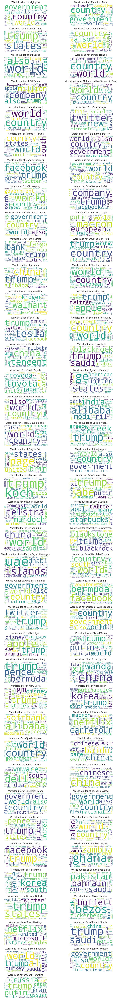

In [90]:
plot_word_cloud(tfIDF_full,corpus_full) # Plot wordclouds for every document

The we can compute the similarity and plot a heatmap

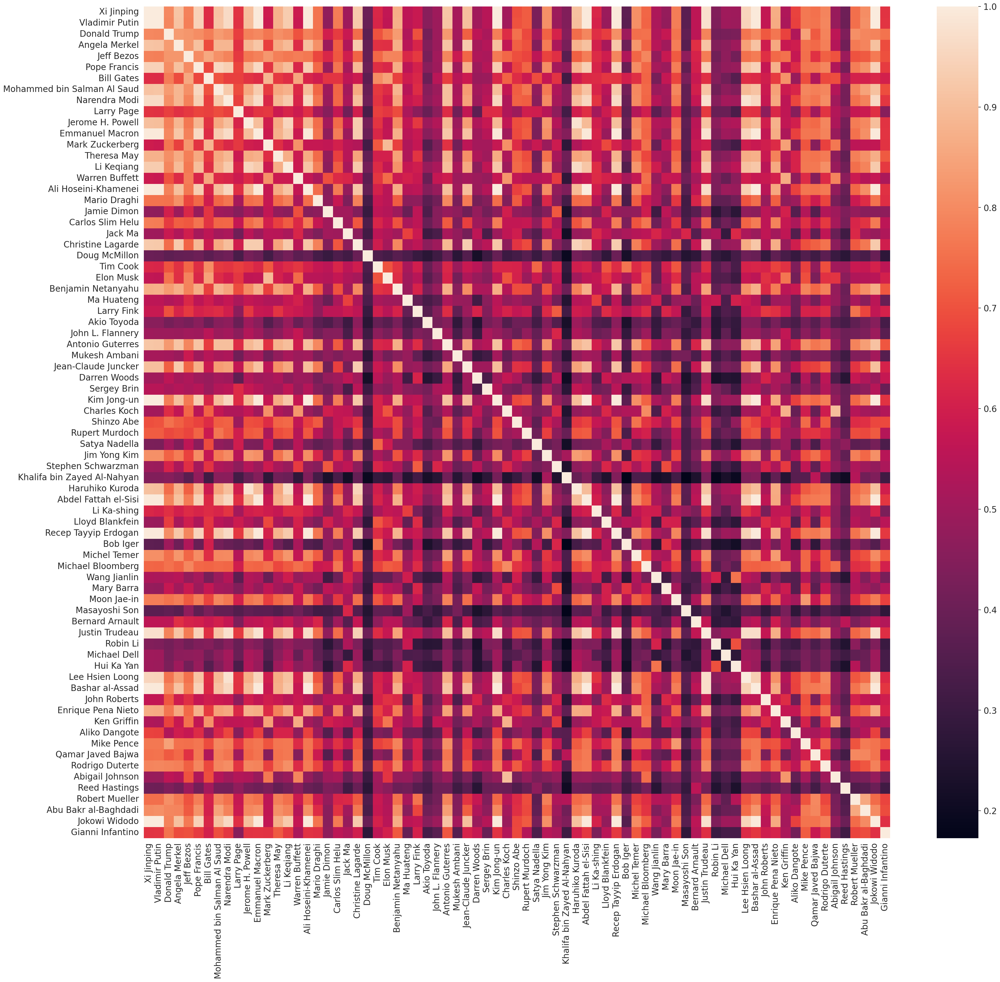

In [91]:
plot_heat_map(vecs_full, corpus_full.keys())

As already mentioned, this sections focuses on the powerful people and all their closest link, meaning in and out going links. One could argue, that the network of the powerful person is only the outgoing links (the ones they know or have a relation to). Therefore it was decided to do this analysis one more time, but only considering the TF-IDF vector of the powerful people plus their out going links. 

### Get TF-IDF for powerful people and their out going link 

Here we extract and merge the wiki content for each person plus their connected (out going edges) nodes (countries and organizations). Then the TF-IDF vectors are computed for each and world clouds are generated for them. Cosine similarity is used to compute the similarity between the TF-IDF vectors and the similarity is then plotted in a heatmap. 

First we compute the corpus (the merged documents) and then we compute the TF-IDF vectors

In [92]:
corpus_only_out_links = get_corpus(G, edge="out")  # Get corpus
tfIDF_only_out_links,vecs_only_out_links = get_IFIDFvectors(corpus_only_out_links)  # Compute TF-IDF vectors

/shared-libs/python3.7/py/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


Using the result, we can plot the word clouds for every powerful person and their network

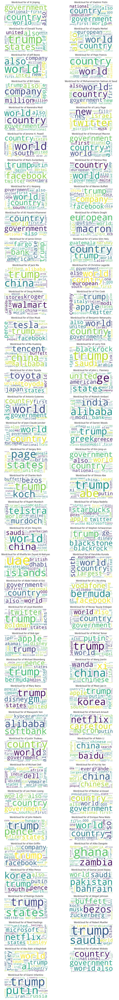

In [93]:
plot_word_cloud(tfIDF_only_out_links,corpus_only_out_links) # Plot wordclouds for every document

The we can compute the similarity and plot a heatmap

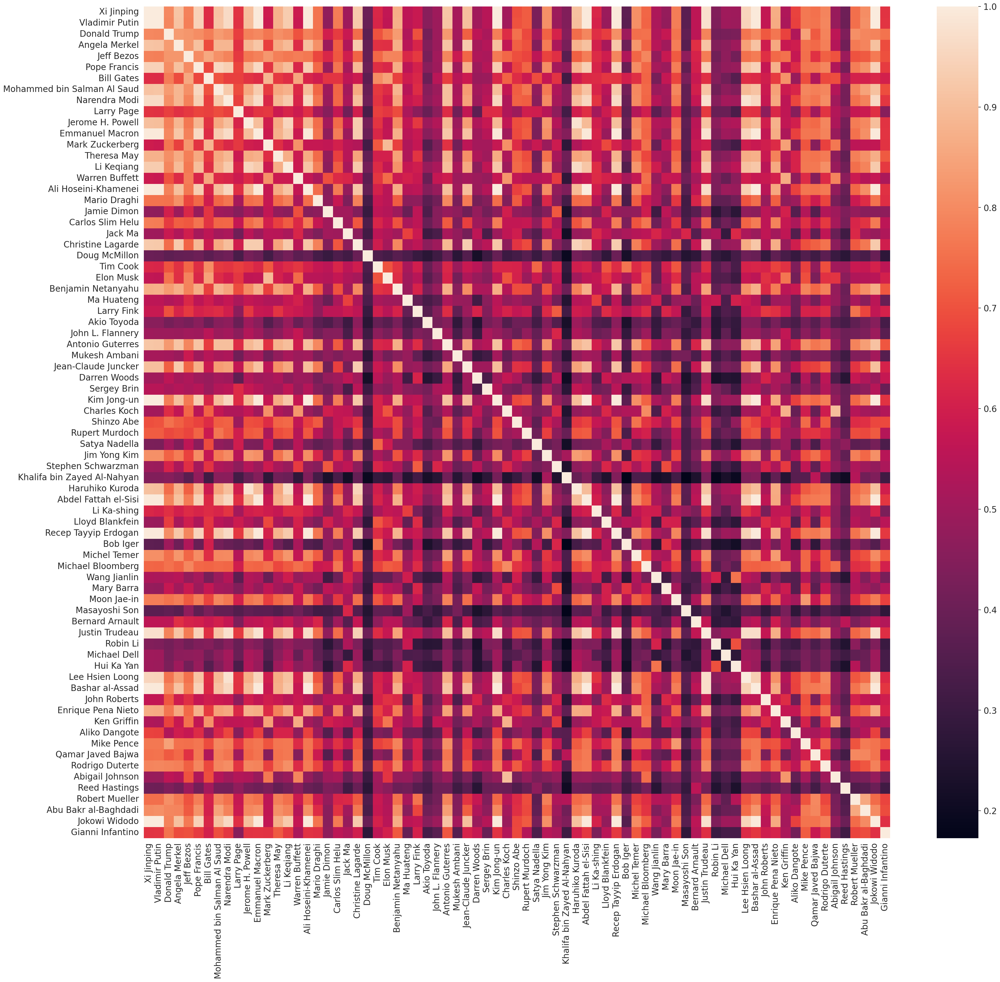

In [94]:
plot_heat_map(vecs_only_out_links, corpus_only_out_links.keys())

From the heatmap we see how similar people are, according to the wikipedia content of themselves and their directly out going linked nodes. We can see that some people are not very similar to anybody else, this includes Masayoshi Son and Khalifa bin Zayed Al-Nahyan. On the other hand there are multiple powerful people who are similar (in terms of them selves and their network). We can e.g. see that Xi Jinping is very similar to Putin and Emmanuel Macron (probably because they are politicians). 

## Create new weighted network based on similarity between people

Now we want to create a new network from the similarities computes above. Then the network is only based on how similar each powerful person is and then we can find communities within it. The value in doing this is, that it is possible to see which people are most similar and divide them into communities. 

Here we take the computed similarity between each person and create a new weighted networks where the weights correspond to the similarity.

In [95]:
def generate_weighted_network(vecs, names):
    """ Computes the similarity between powerful people according to their TF-IDF vectors

    Parameters
    ----------
    vecs: matrix
        Vecs is a document-term matrix.
    names : list
        list of labels to the heatmap

    """    
    
    # compute the cosine similarity matrix
    cosine_sim = cosine_similarity(vecs, vecs)
    simmilaritymeasure = pd.DataFrame(cosine_sim, columns=names, index=names)
    return simmilaritymeasure
  

In [96]:
similarity_df = generate_weighted_network(vecs_only_out_links, corpus_only_out_links.keys())

Create the graph as

In [97]:
weighted_G = nx.Graph()
weighted_G.add_nodes_from(corpus_only_out_links.keys()) # Get nodes from powerful people unique list

nx.set_node_attributes(weighted_G, "person", "node_type") # Add type attribute

# Add attributes to new network
for node in weighted_G.nodes():
    weighted_G.nodes[node]["wiki_content"] = nx.get_node_attributes(G,'wiki_content')[node] # Add wiki content
    weighted_G.nodes[node]["role"] = nx.get_node_attributes(G,'role')[node] # Add role of powerful people


Now we extract all the unique combination of powerful people. By iterating over it we add links between the nodes and give the links a weight which correspond to the similarity. 

In [98]:
# Get all unique combinations of powerful people
combination_of_powerful_people = [comb for comb in itertools.combinations(corpus_only_out_links.keys(), 2)]

In [99]:
# Iterate through combinations
for u,v in combination_of_powerful_people: 
    # Get weight for combination of powerful people
    w = similarity_df.iloc[similarity_df.columns.get_loc(u),similarity_df.columns.get_loc(v)] 

    weighted_G.add_edge(u,v, weight=w) # Add wwighted link


Now we have the weighted network and compute the communites and plot them

Removed zero degree nodes: []
100%|██████████| 2000/2000 [00:00<00:00, 2199.39it/s]
BarnesHut Approximation  took  0.13  seconds
Repulsion forces  took  0.27  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.39  seconds
AdjustSpeedAndApplyForces step  took  0.04  seconds


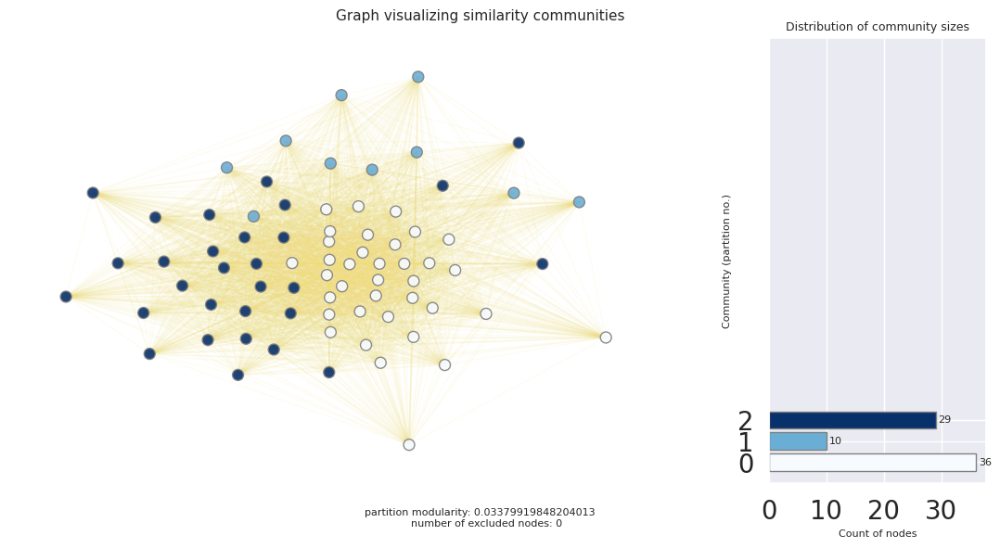

In [100]:
# Get communities
partition_simmilarity_community = find_internal_communities(weighted_G, "Blues", 'Graph visualizing similarity communities')

From the community detection we can determine that there are 3 different communities. There are 2 relatively large ones and one small. This also indicates that there are three different types of powerful people. But what is special about the different three kinds? To discover this, we use TF-IDF vectors again to plot the wordclouds.

Now we compute the TF-IDF vectors for each community and plot the wordcloud as done before

In [101]:
def merge_community_documents(community_number,partition):
  """
  Merges all documents within a community into a single file
  """
  # Get nodes in community with corresponding community_number
  nodes = (
    node
    for node, data in partition.items() if data == community_number
  )

  # Get community with corresponding community_number
  subG = G.subgraph(nodes).to_undirected()
  wiki = nx.get_node_attributes(subG, 'wiki_content') # Get every wiki content in community
  return ' '.join(map(str, wiki.values())) # Merge all wiki content and return

In [102]:
corpus = {} # Define corpus

# Create single document for every community and add to corpus
for i in range(3):
  corpus[i] = clean_file(merge_community_documents(i, partition_simmilarity_community))+''

In [103]:
tfIDF_community ,vecs_community = get_IFIDFvectors(corpus) # Get TF-IDF vectors

/shared-libs/python3.7/py/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


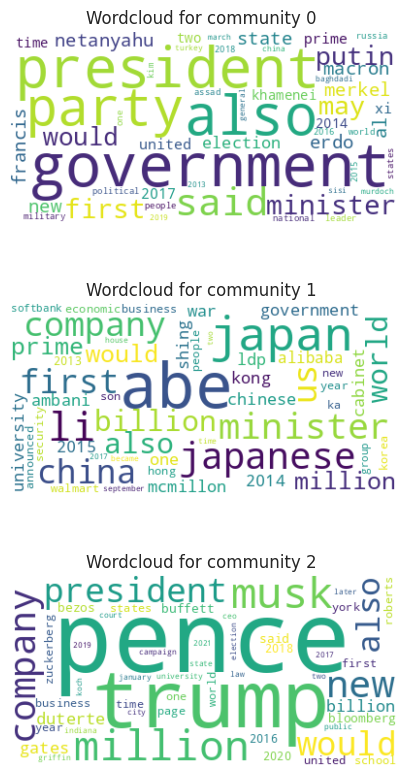

In [104]:
# Plot wordclouds
fig = plt.figure(figsize=(5,10))
for i in range(len(corpus)):
    ax = fig.add_subplot(3,1,i+1)
    sns.set(font_scale=1)
    Cloud = WordCloud(background_color="white", max_words=50).generate_from_frequencies(tfIDF_community.T[i])
    plt.imshow(Cloud, interpolation='bilinear')
    plt.title("Wordcloud for community {0} ".format(list(corpus.keys())[i]))
    plt.axis("off")

From the word clouds we see that the first wordcloud paint a picture of politicians, ministers, presidents and generally people withing the government. The second wordcloud illustrates more popular people such as trump, pence, bezos, elon mush, Warren Buffet and the word million appears which may indicate that it is rich famous powerful people.

### How is the modularity of the detected communities?

In [105]:
modularity_similarity_community = community.modularity(partition_simmilarity_community,weighted_G,weight='weight')
print("Modularity for similarity based communities is : ", modularity_similarity_community)

Modularity for similarity based communities is :  0.03379919848204013


The modularity is quite low.

Modularity is a measure of the structure of a graph, measuring the density of connections within a module or community. Graphs with a high modularity score will have many connections within a community but only few pointing outwards to other communities.

### Which people are in which communities?

Here we list which people are in the 3 different communities.

People in community 1

In [106]:
# First community
# Third community
pd.DataFrame([u for u,v in partition_simmilarity_community.items() if v==0], columns=["People in community 0"])

,People in community 0
0,Xi Jinping
1,Vladimir Putin
2,Angela Merkel
3,Pope Francis
4,Mohammed bin Salman Al Saud
5,Narendra Modi
6,Jerome H. Powell
7,Emmanuel Macron
8,Theresa May
9,Li Keqiang


People in community 2

In [107]:
# Second community
pd.DataFrame([u for u,v in partition_simmilarity_community.items() if v==1], columns=["People in community 1"])

,People in community 1
0,Jack Ma
1,Doug McMillon
2,Ma Huateng
3,Mukesh Ambani
4,Shinzo Abe
5,Li Ka-shing
6,Wang Jianlin
7,Masayoshi Son
8,Robin Li
9,Hui Ka Yan


People in community 3

In [108]:
# Third community
pd.DataFrame([u for u,v in partition_simmilarity_community.items() if v==2], columns=["People in community 2"])

,People in community 2
0,Donald Trump
1,Jeff Bezos
2,Bill Gates
3,Larry Page
4,Mark Zuckerberg
5,Warren Buffett
6,Jamie Dimon
7,Tim Cook
8,Elon Musk
9,Larry Fink


### Is there a clear difference between the roles of the powerful people in the different communities? 

Here we create word clouds for all the roles in the different communities, to see if there is a clear distinction. 

In [109]:
def plot_role_wordcloud(G, partition, number_communities):
    """ Plotting role wordclouds

    Parameters
    ----------
    G: Networkx
        A network
    partition: dict
        Dictionary containing partition of community
    number_communities : number
        Number of communities

    """    

  
    
    fig = plt.figure(figsize=(5,10))
    for i in range(number_communities):

        # Initialize plot
        ax = fig.add_subplot(number_communities,1,i+1)
        sns.set(font_scale=1)

        # Get roles in community with corresponding community_number
        roles_in_community = (
            nx.get_node_attributes(G,'role')[node]
            for node in G.nodes() if ((partition[node]== i) and (nx.get_node_attributes(G,'role')[node] != None))
        )


        # Get role description before "," in role and merge all 
        text = " ".join(val.split(",")[0] for val in roles_in_community)
        word_cloud = WordCloud(collocations = False, background_color = 'white').generate(text) # Make word cloud
        # Show word cloud
        plt.imshow(word_cloud, interpolation='bilinear')
        plt.title("Wordcloud of roles in community {0} ".format(i))
        plt.axis("off")


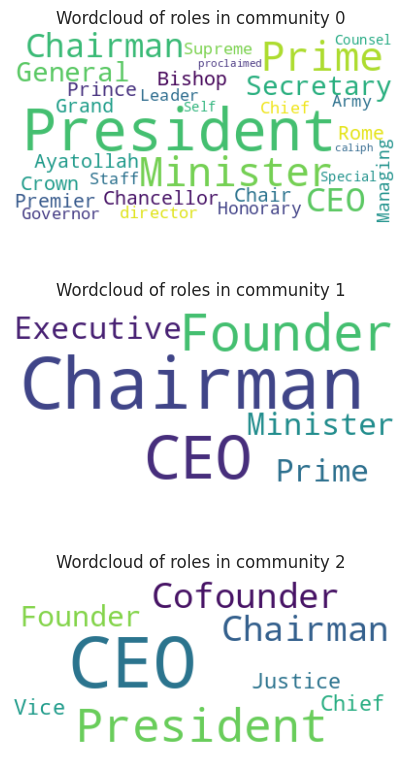

In [110]:
plot_role_wordcloud(weighted_G, partition_simmilarity_community, 3)


<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=09330ec1-178e-4ba4-9605-6959c57642d5' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>